# 100m Sprint Analysis – Paris 2024 Olympics

This project analyzes elite sprinters from the **Paris 2024 Olympic 100m Final** using cutting edge video based biomechanics. With just a video of the race, we extract 3D skeleton data and calculate detailed performance metrics for each athlete, no sensors or wearables needed.
We start with a high quality race video and use AI powered pose estimation tools (like MediaPipe) to track the movement of each athlete. These tools detect key joints (like shoulders, hips, knees, and ankles) in every video frame and generate 3D skeleton data, a simplified stick figure version of the athlete’s motion.

In [1]:
# Import essential libraries for data manipulation, visualization, and analysis
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import plotly.express as px
from matplotlib.lines import Line2D
from sklearn.metrics import accuracy_score, precision_score, recall_score
from scipy.signal import savgol_filter

# Ground Truth Data
The ground truth consists of binary contact labels (0s and 1s) for each athlete's left and right leg across all video frames.
These values indicate whether a leg is in contact with the ground at a given frame:
  - A value of 1 means the leg is in contact with the ground (stance phase).
  - A value of 0 means the leg is not in contact with the ground (swing phase).
This data serves as a reference for evaluating predicted foot contact derived from pose estimation analysis.

In [2]:
# Load ground truth binary contact data (e.g., whether a foot is in contact with the ground) for all athletes and lanes
ground_truth=pd.read_csv("athlete_binary_contact_data.csv")
# Convert each column of the ground truth DataFrame into separate lists for each athlete's left and right foot
individual_2_left=ground_truth['2_L'].tolist()
individual_2_right=ground_truth['2_R'].tolist()
individual_3_left=ground_truth['3_L'].tolist()
individual_3_right=ground_truth['3_R'].tolist()
individual_4_left=ground_truth['4_L'].tolist()
individual_4_right=ground_truth['4_R'].tolist()
individual_5_left=ground_truth['5_L'].tolist()
individual_5_right=ground_truth['5_R'].tolist()
individual_6_left=ground_truth['6_L'].tolist()
individual_6_right=ground_truth['6_R'].tolist()
individual_7_left=ground_truth['7_L'].tolist()
individual_7_right=ground_truth['7_R'].tolist()
individual_8_left=ground_truth['8_L'].tolist()
individual_8_right=ground_truth['8_R'].tolist()
individual_9_left=ground_truth['9_L'].tolist()
individual_9_right=ground_truth['9_R'].tolist()
ground_truth

,Frame,2_L,2_R,3_L,3_R,4_L,4_R,5_L,5_R,6_L,6_R,7_L,7_R,8_L,8_R,9_L,9_R
0,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
2,2,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
3,3,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
4,4,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
245,245,0,0,0,0,0,0,0,1,0,1,0,1,0,0,0,0
246,246,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
247,247,1,0,0,1,0,1,0,1,0,0,0,0,0,0,1,0
248,248,1,0,0,1,0,1,0,0,0,0,0,0,0,1,1,0


# Custom Class SkeletonAnalyzerFineTune1  
# ----------------------------------------
The SkeletonAnalyzerFineTune1 class is a custom built analytical tool designed to process and interpret
3D human pose data (typically from motion capture or pose estimation systems) for sprinting athletes.
Its primary focus is to detect ground contact events and extract biomechanical performance metrics
such as step rate, step length, and speed from video frame data.

Key Responsibilities:
1. Data Standardization:
   - Loads raw 3D joint coordinate data from CSV.
   - Computes mid-hip and neck reference points.
   - Normalizes all joint positions relative to body center and average shoulder width.
   
2. Coordinate Rotation:
   - Applies 3D rotation to align the skeleton consistently across samples.
   
3. Contact Detection:
   - Computes vertical (z-axis) distances between mid-hip and ankles.
   - Smooths signals and detects peaks to classify contact vs. airborne phases for each foot.

4. Threshold Classification:
   - Uses heuristics and smoothing to determine when the left and right foot contact starts.
   - Labels frames where either, both, or neither foot is in contact with the ground.

5. Evaluation:
   - Compares classified contact labels to ground truth using accuracy, precision, and recall.

6. Visualization:
   - Generates interactive 3D skeleton animations (Plotly).
   - Plots smoothed contact signals with colored classifications.

7. Gait Metrics:
   - Computes step rate (frequency of alternating foot contacts).
   - Calculates step length from maximum ankle separation during flight.
   - Estimates running speed from step length and rate.
   - Handles unit conversion using a real world scaling factor.

8. Utility Functions:
   - Smooths outlier data.
   - Visualizes per frame contact state with color coded scatter plots.

This class is highly useful for analyzing sprint mechanics frame by frame,
providing both quantitative measures and visual diagnostics from pose data.

In [3]:
class SkeletonAnalyzerFineTune1:
    def __init__(self, input_csv):
        """
        Constructor: Initialize the SkeletonAnalyzerFineTune1 class
        Parameters:
        - input_csv: str
            Path to the CSV file containing raw 3D pose data (joint coordinates per frame).
        This method sets up key attributes such as:
        - The input and output file paths.
        - Containers for the processed DataFrame, contact analysis thresholds, and derived metrics.
        """
        self.input_csv = input_csv
        self.df = None
        self.thresholds = {'left': [], 'right': []}
        self.colors = []
        self.right_start_threshold = 0
        self.left_start_threshold = 0
        self.dominant = None
        self.normaldf = None
        self.sf = 0
        self.step_length = None
        self.step_rate = None

    def fill_missing_data(self, output_csv):
        """
        Fill Missing Data in Pose Dataset
        This method reads the raw 3D joint data from the input CSV file, performs linear interpolation
        to fill in any missing (NaN) values, and saves the cleaned dataset to a new CSV file.
        Parameters:
        - output_csv: str
            The path where the interpolated dataset should be saved.
        Functionality:
        - Loads the dataset from the existing input CSV path.
        - Applies linear interpolation to estimate and fill in missing values (frame-wise).
        - Saves the resulting complete dataset to the specified output CSV path.
        - Updates the class's input_csv path to point to the newly saved (cleaned) file.
        - Prints a confirmation message with the save location.
        """
        df = pd.read_csv(self.input_csv)
        df = df.interpolate(method='linear')
        df.to_csv(output_csv, index=False)
        self.input_csv = output_csv
        print(f"Interpolated dataset saved as: {output_csv}")

    def load_and_standardize(self):
        """
        Load and Standardize 3D Pose Data
        This method loads raw 3D pose data from the input CSV file and standardizes it
        for consistent biomechanical analysis.
        Key Steps:
        1. Load the pose data into a DataFrame.
        2. Compute new joint landmarks:
           - 'neck': midpoint between left and right shoulders.
           - 'midhip': midpoint between left and right hips.
        3. Translate all 3D joint coordinates (x, y, z) so that the midhip becomes the origin.
           - This removes global position offsets and centers the skeleton.
        4. Normalize all joint coordinates by the average shoulder width (Euclidean distance between shoulders).
           - This accounts for body size variation across athletes.
        5. Add a 'frame' column to preserve the original frame indexing.
        6. Store the standardized DataFrame in self.df for use in further analysis steps.
        """
        df = pd.read_csv(self.input_csv)
        df['neck_x'] = (df['left_shoulder_x'] + df['right_shoulder_x']) / 2
        df['neck_y'] = (df['left_shoulder_y'] + df['right_shoulder_y']) / 2
        df['neck_z'] = (df['left_shoulder_z'] + df['right_shoulder_z']) / 2
        df['midhip_x'] = (df['left_hip_x'] + df['right_hip_x']) / 2
        df['midhip_y'] = (df['left_hip_y'] + df['right_hip_y']) / 2
        df['midhip_z'] = (df['left_hip_z'] + df['right_hip_z']) / 2
        for axis in ['x', 'y', 'z']:
            for col in df.columns:
                if col.endswith(f'_{axis}') and not col.startswith('frame'):
                    df[col] -= df[f'midhip_{axis}']
        shoulder_dist = np.linalg.norm(
            df[['left_shoulder_x', 'left_shoulder_y', 'left_shoulder_z']].values -
            df[['right_shoulder_x', 'right_shoulder_y', 'right_shoulder_z']].values, axis=1)
        avg_width = shoulder_dist.mean()
        for col in df.columns:
            if any(col.endswith(f'_{axis}') for axis in ['x', 'y', 'z']):
                df[col] /= avg_width
        df['frame'] = df.index
        self.df = df

    def rotate_coordinates(self, angle_x=270, angle_y=0, angle_z=0):
        """
        Apply 3D Rotation to Standardized Coordinates
        This method rotates the entire skeleton's 3D coordinates around the X, Y, and Z axes
        to align all poses into a consistent viewing orientation. This is helpful for
        comparative visualization and analysis across athletes or sessions.
        Parameters:
        - angle_x, angle_y, angle_z (default: 270°, 0°, 0°):
            Rotation angles in degrees around the X, Y, and Z axes respectively.
        Key Steps:
        1. Convert input angles from degrees to radians for trigonometric functions.
        2. Define standard 3D rotation matrices Rx, Ry, Rz for the X, Y, and Z axes.
        3. Combine them into a single rotation matrix R using matrix multiplication (Z @ Y @ X order).
        4. Identify all joint coordinate columns in the DataFrame (ending in _x, _y, _z).
        5. For each triplet (x, y, z) corresponding to a body joint:
           - Apply the rotation matrix to the joint’s 3D position.
           - Replace the original coordinates with the rotated values.
        """
        ax, ay, az = np.radians([angle_x, angle_y, angle_z])
        Rx = np.array([[1, 0, 0], [0, np.cos(ax), -np.sin(ax)], [0, np.sin(ax), np.cos(ax)]])
        Ry = np.array([[np.cos(ay), 0, np.sin(ay)], [0, 1, 0], [-np.sin(ay), 0, np.cos(ay)]])
        Rz = np.array([[np.cos(az), -np.sin(az), 0], [np.sin(az), np.cos(az), 0], [0, 0, 1]])
        R = Rz @ Ry @ Rx
        coords = [col for col in self.df.columns if col.endswith(('_x', '_y', '_z'))]
        for i in range(0, len(coords), 3):
            x, y, z = coords[i:i+3]
            values = self.df[[x, y, z]].values
            rotated = values.dot(R.T)
            self.df[x], self.df[y], self.df[z] = rotated[:, 0], rotated[:, 1], rotated[:, 2]

    def compute_differences(self):
        """
        Compute Vertical Distance Differences Between Midhip and Ankles
        This method calculates the absolute vertical (z-axis) distance between the midhip joint
        and each ankle (left and right) for every frame. These differences serve as a proxy
        for estimating ground contact: smaller distances may indicate contact,
        while larger distances may indicate the leg is in the air.
        Key Steps:
        1. Compute `diff1`: vertical distance between midhip and right ankle (absolute difference).
        2. Compute `diff2`: vertical distance between midhip and left ankle (absolute difference).
           - Absolute values ensure comparison is height-based and direction-agnostic.
        3. Normalize both `diff1` and `diff2` to the range [0, 1] using their respective maxima.
           - This scaling ensures consistent thresholding across different sessions or subjects.
        """
        self.df['diff1'] = abs(abs(self.df['midhip_z']) - abs(self.df['right_ankle_z']))
        self.df['diff2'] = abs(abs(self.df['midhip_z']) - abs(self.df['left_ankle_z']))
        self.df['diff1_norm'] = self.df['diff1'] / self.df['diff1'].max()
        self.df['diff2_norm'] = self.df['diff2'] / self.df['diff2'].max()

    def correct_outliers(self):
        """
        Correct Outliers and Smooth Contact Signals
        This method performs two main tasks to clean the normalized midhip and ankle distance signals:
        1. Outlier Correction:
           - For each normalized signal (`diff1_norm` for right leg, `diff2_norm` for left leg), it checks every point
             (excluding the first and last) to detect sharp spikes.
           - If the current point significantly deviates (> 0.3) from both its immediate neighbors,
             it is considered an outlier.
           - The outlier is corrected by replacing it with the average of its neighbors.
        2. Signal Smoothing:
           - Applies a Savitzky-Golay filter to the cleaned signals to reduce noise and preserve peak structure.
           - Produces two smoothed columns: `diff1_smooth` and `diff2_smooth`.
        """
        for col in ['diff1_norm', 'diff2_norm']:
            y = self.df[col].values.copy()
            for i in range(1, len(y) - 1):
                prev_diff = abs(y[i] - y[i - 1])
                next_diff = abs(y[i] - y[i + 1])
                if prev_diff > 0.3 and next_diff > 0.3:
                    y[i] = (y[i - 1] + y[i + 1]) / 2  
            self.df[col] = y
        self.df['diff1_smooth'] = savgol_filter(self.df['diff1_norm'], window_length=7, polyorder=4)
        self.df['diff2_smooth'] = savgol_filter(self.df['diff2_norm'], window_length=7, polyorder=4)
    
    def detect_dip_start(self, col1='diff1_smooth', col2='diff2_smooth', window=5, drop_threshold=0.05):
        """
        Detect Initial Dip in Smoothed Contact Signal (Start of Foot Contact Phase)
        This method estimates the starting frame where each leg (right and left) begins
        its first significant dip in the smoothed distance signal indicating the onset
        of ground contact detection.
        Parameters:
        - col1: str (default = 'diff1_smooth')
            The smoothed vertical distance signal for the right leg (midhip - right ankle).
        - col2: str (default = 'diff2_smooth')
            The smoothed vertical distance signal for the left leg (midhip - left ankle).
        - window: int (default = 5)
            Number of frames used to calculate local averages before and after the current frame.
        - drop_threshold: float (default = 0.05)
            Minimum difference between the stable (past) average and future average required
            to consider the signal as beginning to "dip".
        Method Logic:
        - For each leg, iterate through the signal starting from the 'window' index.
        - Compute the average of the previous `window` frames (stable phase) and the following `window` frames.
        - If the difference (drop) between these averages exceeds the threshold, mark that frame
          as the dip start (contact onset) and store it as `right_start_threshold` or `left_start_threshold`.
        """
        values = self.df[col1].values
        for i in range(window, len(values) - window):
            stable_avg = np.mean(values[i - window:i])
            future_avg = np.mean(values[i:i + window])
            drop = stable_avg - future_avg
            if drop > drop_threshold:
                self.right_start_threshold = self.df['frame_id'].iloc[i]
                break
        values = self.df[col2].values
        for i in range(window, len(values) - window):
            stable_avg = np.mean(values[i - window:i])
            future_avg = np.mean(values[i:i + window])
            drop = stable_avg - future_avg
            if drop > drop_threshold:
                self.left_start_threshold = self.df['frame_id'].iloc[i]
                break
    
    def classify_thresholds(self, dominant_leg="Right", threshold=0.65, first_threshold=0.52):
        """
        Classify Foot Contact Phases Based on Thresholded Signal Peaks
        This method uses peak detection and thresholding on the smoothed midhip and ankle distance signals
        to classify frames where each leg is in contact with the ground (1 = contact, 0 = air).
        Parameters:
        - dominant_leg: str ("Right" or "Left")
            Specifies the dominant leg of the athlete. Used to slightly offset threshold timing to favor early detection.
        - threshold: float (default = 0.65)
            The standard threshold value to detect peaks indicating ground contact.
        - first_threshold: float (default = 0.52)
            A lower threshold used specifically for the first 1–2 detected peaks, which may be smaller than usual.
        Key Steps:
        1. Adjust Start Thresholds:
           - If the dominant leg is "Right", delay left contact detection slightly more than right (and vice versa).
        2. Signal Selection:
           - Choose which signal to analyze: smoothed (`diff_smooth`) for the dominant leg, or normalized (`diff_norm`) for the non-dominant leg.
        3. Peak Detection:
           - Define an inner function `find_peaks()` that scans the signal from the adjusted start frame.
           - A peak is detected if the value is greater than both neighbors and exceeds the threshold.
           - The first peak(s) may use a lower `first_threshold` to allow for subtle initial contact phases.
        4. Contact Range Assignment:
           - Define `assign_contact_range()` to mark surrounding frames as "in contact" as long as values stay above the current threshold.
           - Apply this to both left and right legs using the detected peak positions.
        5. Pre-threshold Frames:
           - Set all frames prior to each leg’s start threshold as contact (value = 1), assuming initial stance phase.
        6. Store Results:
           - Save left and right contact classification results in `self.thresholds`.
           - Also attach the labels to the main DataFrame (`threshold_left`, `threshold_right`) for downstream analysis.
        """
        self.dominant = dominant_leg
        if dominant_leg == 'Right':
            self.left_start_threshold += 10
            self.right_start_threshold += 5
        else:
            self.left_start_threshold += 5
            self.right_start_threshold += 10
        x = np.array(self.df['frame_id']) / 30
        y_left = self.df['diff2_smooth'].values if dominant_leg == "Right" else self.df['diff2_norm'].values
        y_right = self.df['diff1_smooth'].values if dominant_leg == "Right" else self.df['diff1_norm'].values
        n = len(self.df)
        left = [0] * n
        right = [0] * n
        def find_peaks(y, label):
            start = int(self.left_start_threshold) if label == "left" else int(self.right_start_threshold)
            peaks = []
            for i in range(start, len(y) - 1):
                if len(peaks) == 0:
                    if y[i] > first_threshold and y[i] >= y[i - 1] and y[i] >= y[i + 1]:
                        peaks.append((x[i], i, label, y[i]))
                if y[i] > threshold and y[i] >= y[i - 1] and y[i] >= y[i + 1]:
                    peaks.append((x[i], i, label, y[i]))
            return peaks
        left_peaks = find_peaks(y_left, "left")
        right_peaks = find_peaks(y_right, "right")
        def assign_contact_range(y, peaks, output, use_first_threshold):
            for idx, (_, peak_idx, _, _) in enumerate(peaks):
                thresh = first_threshold if idx == 0 or idx == 1 and use_first_threshold else threshold
                i = peak_idx
                while i < len(y) and y[i] > thresh:
                    output[i] = 1
                    i += 1
        assign_contact_range(y_left, left_peaks, left, use_first_threshold=True)
        assign_contact_range(y_right, right_peaks, right, use_first_threshold=True)
        for i in range(int(self.left_start_threshold)):
            left[i] = 1
        for i in range(int(self.right_start_threshold)):
            right[i] = 1
        self.thresholds['left'] = left
        self.thresholds['right'] = right
        self.df['threshold_left'] = left
        self.df['threshold_right'] = right

    def evaluate(self, ground_truth_left, ground_truth_right):
        """
        Evaluate Contact Classification Against Ground Truth Labels
        This method compares the predicted foot contact labels (from threshold classification)
        with the actual ground truth labels for both left and right legs.
        Parameters:
        - ground_truth_left: list or array-like
            Ground truth binary contact labels (0 or 1) for the left leg.
        - ground_truth_right: list or array-like
            Ground truth binary contact labels (0 or 1) for the right leg.
        Returns:
        - results: dict
            A dictionary containing accuracy, precision, and recall scores for each leg.
        Metrics Computed:
        - Accuracy: Overall proportion of correctly classified frames.
        - Precision: Proportion of predicted contacts that were actually correct (true positives / predicted positives).
        - Recall: Proportion of actual contacts that were correctly predicted (true positives / actual positives).
        """
        results = {
            'left': {
                'accuracy': accuracy_score(ground_truth_left, self.thresholds['left']),
                'precision': precision_score(ground_truth_left, self.thresholds['left']),
                'recall': recall_score(ground_truth_left, self.thresholds['left']),
            },
            'right': {
                'accuracy': accuracy_score(ground_truth_right, self.thresholds['right']),
                'precision': precision_score(ground_truth_right, self.thresholds['right']),
                'recall': recall_score(ground_truth_right, self.thresholds['right']),
            }
        }
        return results

    def visualize_skeleton(self, save_html='skeleton_animation.html'):
        """
        Visualize 3D Skeleton Animation Using Plotly
        This method creates an interactive 3D visualization of the athlete's skeleton using
        joint landmark coordinates across all frames. It helps visually validate the pose data
        and assess joint movement over time.
        Parameters:
        - save_html: str (default = 'skeleton_animation.html')
            File path to save the resulting Plotly animation as an interactive HTML file.
        Key Components:
        - `landmarks`: List of body joints used for visualization (e.g., shoulders, hips, ankles).
        - `connections`: Pairs of landmarks that form the skeleton’s bones (used to draw lines between joints).
        Visualization Steps:
        1. For each joint (landmark), create a 3D scatter plot using its x, y, z coordinates across frames.
        2. For each bone (connection between two joints), draw a 3D line segment connecting the corresponding coordinates.
        3. Configure the layout to preserve equal scaling across all axes for realistic body proportions.
        4. Save the animation as an HTML file and display it inline (if running in a notebook environment).
        """
        landmarks = ['neck', 'midhip', 'left_shoulder', 'right_shoulder', 'left_elbow', 'right_elbow',
                     'left_wrist', 'right_wrist', 'left_hip', 'right_hip', 'left_knee', 'right_knee',
                     'left_ankle', 'right_ankle']
        connections = [('neck', 'left_shoulder'), ('neck', 'right_shoulder'),
                       ('left_shoulder', 'left_elbow'), ('left_elbow', 'left_wrist'),
                       ('right_shoulder', 'right_elbow'), ('right_elbow', 'right_wrist'),
                       ('neck', 'midhip'), ('midhip', 'left_hip'), ('midhip', 'right_hip'),
                       ('left_hip', 'left_knee'), ('left_knee', 'left_ankle'),
                       ('right_hip', 'right_knee'), ('right_knee', 'right_ankle')]
        fig = go.Figure()
        for lm in landmarks:
            fig.add_trace(go.Scatter3d(
                x=self.df[f'{lm}_x'], y=self.df[f'{lm}_y'], z=self.df[f'{lm}_z'],
                mode='markers', name=lm, marker=dict(size=2)))
        for start, end in connections:
            fig.add_trace(go.Scatter3d(
                x=pd.concat([self.df[f'{start}_x'], self.df[f'{end}_x']]),
                y=pd.concat([self.df[f'{start}_y'], self.df[f'{end}_y']]),
                z=pd.concat([self.df[f'{start}_z'], self.df[f'{end}_z']]),
                mode='lines', line=dict(color='blue', width=2), name=f'{start}-{end}'))
        fig.update_layout(scene_aspectmode='cube', title='3D Skeleton Animation')
        fig.write_html(save_html)
        fig.show()

    def visualize_thresholds(self):
        """
        Visualize Foot Contact Thresholds Over Time
        This method generates scatter plots to visualize the smoothed vertical distance signals
        (midhip to ankle) for both legs, color coded by their binary contact classification.
        Functionality:
        - Creates two separate scatter plots using Plotly Express:
          - One for the left leg (`diff2_smooth` vs. frame ID), color-coded by `threshold_left`.
          - One for the right leg (`diff1_smooth` vs. frame ID), color-coded by `threshold_right`.
        Visual Cues:
        - Red points (1): Frames where the leg is classified as in contact with the ground.
        - Blue points (0): Frames where the leg is airborne.
        Purpose:
        - These plots help visually confirm whether the threshold based classification
          correctly segments foot contact and swing phases.
        Notes:
        - The function also sets `frame_id` for labeling the x-axis.
        - Plots are displayed interactively for easy analysis.
        """
        self.df['frame_id'] = self.df['frame']
        fig_left = px.scatter(self.df, x='frame_id', y='diff2_smooth',
                              color=self.df['threshold_left'].astype(str),
                              title='Midhip Z vs Left Ankle Z Diff',
                              color_discrete_map={'0': 'blue', '1': 'red'})
        fig_right = px.scatter(self.df, x='frame_id', y='diff1_smooth',
                               color=self.df['threshold_right'].astype(str),
                               title='Midhip Z vs Right Ankle Z Diff',
                               color_discrete_map={'0': 'blue', '1': 'red'})
        fig_left.show()
        fig_right.show()

    def plot_combined_leg_classification(self):
        """
        Plot Combined Leg Contact Classification Per Frame
        This method visualizes the contact state of both legs (left and right) for each frame
        by assigning a unique color to each possible combination of foot contact:
        Color Coding Scheme:
        - Green  : Both legs in contact with the ground
        - White  : Both legs in the air (flight phase)
        - Blue   : Only the left leg is in contact
        - Red    : Only the right leg is in contact
        Visualization Steps:
        1. Iterate through all frames and compare left/right contact labels (0 or 1).
           - Build a corresponding color list for each frame based on the contact state.
        2. Plot the classification as a scatter plot:
           - X-axis: frame index (`frame_id`)
           - Y-axis: constant value (1), since we only care about frame-wise contact status.
           - Each point is colored based on the leg contact combination.
        3. Add a custom legend using `Line2D` objects to clearly label each color category.
        4. Style the plot with grid lines, axis labels, and suppress y-axis ticks for clarity.
        Returns:
        - self.colors: list of color codes used for each frame (for further visualizations if needed).
        """
        self.colors = []
        for l, r in zip(self.thresholds['left'], self.thresholds['right']):
            if l == 1 and r == 1:
                self.colors.append('green')
            elif l == 0 and r == 0:
                self.colors.append('white')
            elif l == 1 and r == 0:
                self.colors.append('blue')
            else:
                self.colors.append('red')
        plt.figure(figsize=(12, 6))
        plt.scatter(self.df['frame_id'], [1]*len(self.df), c=self.colors, edgecolors='black', s=100)
        legend_elements = [
            Line2D([0], [0], marker='o', color='w', label='Both Leg Contact', markerfacecolor='green', markersize=10),
            Line2D([0], [0], marker='o', color='w', label='Both Leg on Air', markerfacecolor='white', markersize=10, markeredgecolor='black'),
            Line2D([0], [0], marker='o', color='w', label='Left Leg Contact', markerfacecolor='blue', markersize=10),
            Line2D([0], [0], marker='o', color='w', label='Right Leg Contact', markerfacecolor='red', markersize=10)
        ]
        plt.legend(handles=legend_elements, title="Class Labels")
        plt.xlabel("Frame ID")
        plt.title("Threshold Classification Per Frame")
        plt.grid(axis='x', linestyle='--', alpha=0.6)
        plt.yticks([])
        plt.show()
        return self.colors

    def compute_contact_air_durations(self):
        """
        Compute Durations of Airborne and Ground Contact Phases
        This method calculates how long the athlete spends in the air (both feet off the ground)
        and in single leg contact (only one foot touching the ground) during the run.
        Logic:
        - Iterates through each frame using the left and right contact classifications.
        - Detects 3 possible states:
          1. **Both Legs in Contact (l==1 and r==1)**: Ignored, not counted as single-leg support.
          2. **Single Leg Contact ((l==1 and r==0) or (l==0 and r==1))**:
               - If transitioning from air, save the accumulated air time.
               - Accumulate contact duration.
          3. **Both Legs in Air (l==0 and r==0)**:
               - If transitioning from contact, save the accumulated contact time.
               - Accumulate air duration.
        Timing:
        - Durations are divided by 30 to convert frame counts into seconds (assuming 30 FPS).
        Returns:
        - air_time: list of durations (in seconds) for each airborne phase.
        - contact_time: list of durations (in seconds) for each single-leg contact phase.
        """
        air_time = []
        contact_time = []
        air = 0
        contact = 0
        current_class = 1
        for l,r in zip(self.thresholds['left'], self.thresholds['right']):
            if not (l==1 and r==1):
                if (l==1 and r==0) or (l==0 and r==1):
                    if air!=0:
                        air_time.append(air/30)
                        air = 0
                    contact += 1
                elif l==0 and r==0:
                    if contact!=0:
                        contact_time.append(contact/30)
                        contact = 0
                    air += 1
        return air_time, contact_time
        
    def compute_step_rate(self):
        """
         Compute Step Rate (Frequency) from Foot Contact Events
        This method calculates the step rate (steps per second) based on alternating foot contact events
        using the frame indices where each foot first touches the ground after the start threshold.
        Key Steps:
        1. Load the original (unprocessed) pose data for reference.
        2. Identify all frames (after the threshold start points) where each foot is classified as in contact.
        3. Filter these indices to find the first frame of each distinct contact period:
           - Ensures no false multiple detections within close frame intervals.
        4. Alternate between left and right contact events to form valid step pairs:
           - For each valid left-to-right or right-to-left sequence, calculate:
               - Step time = time between contacts (in seconds)
               - Step rate = 1 / step time (in Hz)
        5. Skip redundant steps from the same leg (e.g., consecutive lefts or rights).
        Returns:
        - step_rate: A list of dictionaries for each step containing:
            - 'from_leg': Which leg initiated the step.
            - 'start_frame': The contact start frame.
            - 'end_frame': The next contact frame (opposite leg).
            - 'step_time': Duration of the step in seconds.
            - 'step_rate': Step frequency in Hz.
        """
        step_rate = []
        self.normaldf = pd.read_csv(self.input_csv)
        left_start = int(self.left_start_threshold)
        right_start = int(self.right_start_threshold)
        left_contact_indices = [i for i, val in enumerate(self.df['threshold_left']) if val == 1 and i >= left_start]
        right_contact_indices = [i for i, val in enumerate(self.df['threshold_right']) if val == 1 and i >= right_start]
        def get_first_contact_frames(indices):
            contact_frames = []
            prev = -10
            for idx in indices:
                if idx - prev > 5:
                    contact_frames.append(idx)
                    prev = idx
            return contact_frames    
        left_steps = get_first_contact_frames(left_contact_indices)
        right_steps = get_first_contact_frames(right_contact_indices)
        i, j = 0, 0
        prev_step = "None"
        while i < len(left_steps) and j < len(right_steps):
            if left_steps[i] < right_steps[j]:
                if prev_step != "left":
                    l_idx = left_steps[i]
                    r_idx = right_steps[j]
                    step_time = (r_idx - l_idx)/30
                    step_freq = 1 / step_time if step_time != 0 else 0
                    step_rate.append({
                        "from_leg": "left",
                        "start_frame": l_idx,
                        "end_frame": r_idx,
                        "step_time": step_time,
                        "step_rate": step_freq
                    })
                    i += 1
                    prev_step = "left"
                else:
                    i += 1
            elif left_steps[i] > right_steps[j]:
                if prev_step != "right":
                    r_idx = right_steps[j]
                    l_idx = left_steps[i]
                    step_time = (l_idx - r_idx)/30
                    step_freq = 1 / step_time if step_time != 0 else 0
                    step_rate.append({
                        "from_leg": "right",
                        "start_frame": r_idx,
                        "end_frame": l_idx,
                        "step_time": step_time,
                        "step_rate": step_freq
                    })
                    j += 1
                    prev_step = "right"
                else:
                    j += 1  
            else:
                i += 1
                j += 1
        self.step_rate = step_rate
        return step_rate
        
    def compute_step_length(self):
        """
        Compute Step Length Using Maximum Ankle Separation During Air Phase
        This method estimates the step length by analyzing frames where both feet are in the air.
        It calculates the 3D distance between the ankles during these flight phases and records
        the maximum separation as the effective step length.
        Key Logic:
        1. Iterate over each frame and detect "airborne phases" — where both left and right legs
           are not in contact with the ground (`threshold_left == 0` and `threshold_right == 0`).
        2. While in an airborne phase:
           - Record the 3D Euclidean distance between the left and right ankles for each frame.
           - Track the start frame of the airborne segment.
        3. When the air phase ends (i.e., any foot makes contact):
           - Determine the frame within the air phase where ankle separation was maximal.
           - Use this as the step's peak distance (proxy for step length).
           - Infer which leg initiated the step by checking the contact status just before takeoff.
        4. Store the results as a list of dictionaries containing:
           - 'from_leg'     : Leg that pushed off before the air phase.
           - 'start_frame'  : Beginning of air phase.
           - 'end_frame'    : End of air phase.
           - 'max_frame'    : Frame where ankle distance was maximum.
           - 'max_distance' : Maximum 3D ankle separation during the air phase (step length).
        Returns:
        - results: list of dictionaries for each detected step.
        """
        results = []
        in_air = False
        start_idx = None
        distances = []    
        for i in range(len(self.df)):
            l_contact = self.df.loc[i, 'threshold_left']
            r_contact = self.df.loc[i, 'threshold_right']
            if l_contact == 0 and r_contact == 0:  # both feet in air
                if not in_air:
                    in_air = True
                    start_idx = i
                    distances = []
                lx, ly, lz = self.df.loc[i, ['left_ankle_x', 'left_ankle_y', 'left_ankle_z']]
                rx, ry, rz = self.df.loc[i, ['right_ankle_x', 'right_ankle_y', 'right_ankle_z']]
                dist = np.sqrt((lx - rx)**2 + (ly - ry)**2 + (lz - rz)**2)
                distances.append((i, dist))
            elif in_air:
                in_air = False
                end_idx = i - 1
                if distances:
                    max_frame, max_dist = max(distances, key=lambda x: x[1])
                    prev_leg = 'unknown'
                    if start_idx > 0:
                        if self.df.loc[start_idx - 1, 'threshold_left'] == 1:
                            prev_leg = 'left'
                        elif self.df.loc[start_idx - 1, 'threshold_right'] == 1:
                            prev_leg = 'right'
                    results.append({
                        "from_leg": prev_leg,
                        "start_frame": start_idx,
                        "end_frame": end_idx,
                        "max_frame": max_frame,
                        "max_distance": max_dist
                    })
        self.step_length = results
        return results

    def estimate_scale_factor_from_leg_peak(self, peak_index=155, real_leg_length_meters=0.86):
        """
        Estimate Real-World Scale Factor from Normalized Leg Length
        This method calculates a scaling factor to convert normalized pose data (unitless)
        into real-world metric values using an assumed true leg length.
        Parameters:
        - peak_index: int (optional)
            Unused in current implementation but could indicate a frame to extract leg length from.
        - real_leg_length_meters: float (default = 0.86)
            The athlete’s actual leg length in meters (used for reference scaling).
        Process:
        - Uses the maximum value of `diff1_smooth` (midhip-to-right-ankle z-distance)
          as the normalized leg length.
        - Computes the scale factor as:
            scale_factor = real_leg_length / normalized_leg_length
        Output:
        - Stores the scale factor in `self.sf` for use in future metric conversions.
        - Prints both the normalized length and the resulting scale factor.
        - Returns the computed scale factor.
        """
        df = self.df    
        leg_length_normalized = self.df['diff1_smooth'].max()   
        print("leg_length_normalized",leg_length_normalized)
        scale_factor = real_leg_length_meters / leg_length_normalized
        print(f"Leg length at peak (normalized): {leg_length_normalized:.4f} → Scale factor: {scale_factor:.4f}")
        self.sf = float(scale_factor)
        return scale_factor

    def compute_step_difference_per_frame(self):
        """
        Compute and Plot Ankle Distance Per Frame (Step Spread)
        This function calculates the 3D Euclidean distance between the left and right ankles
        for each frame, effectively measuring the step width or stride separation.
        Process:
        - For every frame in the pose data:
            - Extract the ankle positions (x, y, z) for both legs.
            - Compute the Euclidean distance between the two ankles.
            - Multiply the result by the previously estimated scale factor (`self.sf`)
              to convert from normalized units to meters.
        Output:
        - Plots a time series of ankle distance over all frames.
        - Helps visualize stride rhythm, asymmetry, or abnormalities during running.
        """
        step_differences = []
        for i in range(len(self.df)):
            lx, ly, lz = self.df.loc[i, ['left_ankle_x', 'left_ankle_y', 'left_ankle_z']]
            rx, ry, rz = self.df.loc[i, ['right_ankle_x', 'right_ankle_y', 'right_ankle_z']]
            dist = np.sqrt((lx - rx)**2 + (ly - ry)**2 + (lz - rz)**2)
            dist *= self.sf
            step_differences.append(dist)
        plt.plot(step_differences)
        plt.title("Step Difference per Frame")
        plt.xlabel("Frame")
        plt.ylabel("Distance between Ankles")
        plt.grid(True)
        plt.show()

    def compute_speed(self):
        """
        Estimate Running Speed for Each Step
        This method calculates the athlete's running speed for each detected step by
        combining step length (in meters) and step rate (in Hz).
        Process:
        - For each matched entry in `self.step_length` and `self.step_rate`:
            - Convert step length to meters using `self.sf`.
            - Extract the step frequency in Hz.
            - Compute speed as:
                speed = step_length_meters * step_rate_hz
        Returns:
        - A list of dictionaries containing:
            - 'from_leg'       : which leg initiated the step
            - 'start_frame'    : start of the step
            - 'end_frame'      : end of the step
            - 'step_length_m'  : length of the step in meters
            - 'step_rate_hz'   : frequency of the step (Hz)
            - 'speed_mps'      : estimated speed in meters per second (m/s)
        """
        speeds = []    
        for step, rate in zip(self.step_length, self.step_rate):
            length_m = step['max_distance'] * self.sf
            rate_hz = rate['step_rate']    
            speed = length_m * rate_hz  # m/s
            speeds.append({
                'from_leg': step['from_leg'],
                'start_frame': step['start_frame'],
                'end_frame': step['end_frame'],
                'step_length_m': length_m,
                'step_rate_hz': rate_hz,
                'speed_mps': speed
            })
        return speeds

# End-to-End Analysis Pipeline for Athlete from Lane 2 to lane 9
# ---------------------------------------------------------------
This section creates an instance of the SkeletonAnalyzerFineTune1 class
and performs the full biomechanics analysis for the athlete from Lane 2 to lane 9:

- Loads and standardizes 3D pose data from CSV
- Rotates coordinates for consistent orientation
- Computes and smooths vertical ankle-midhip distances
- Detects initial contact thresholds and classifies contact frames
- Visualizes the 3D skeleton and contact thresholds
- Evaluates classification accuracy against ground truth labels
- Calculates air and contact durations per gait cycle
- Computes step rate and step length from foot transitions
- Applies a real-world scale factor based on leg length
- Plots per-frame stride differences and estimates speed

Final outputs include:
- Accuracy/precision/recall scores
- Lists of step rates, step lengths, and speeds (in m/s)

## Using Your Own Dataset
You can use your own skeleton data for analysis. For best results, ensure the input video is high-quality (e.g., similar to broadcast-level footage like the Olympics), as clearer visuals lead to more accurate pose estimations.

### Note on Thresholds
> **Note:**  
> The threshold values used for detecting contact and air phases are sensitive to the scale of the video.  
> If your camera is positioned closer or farther from the athlete compared to the original footage,  
> you may need to **change the thresholds** accordingly to get accurate results.  
> For example, a close-up video may produce larger leg extension values than a wide-angle shot.

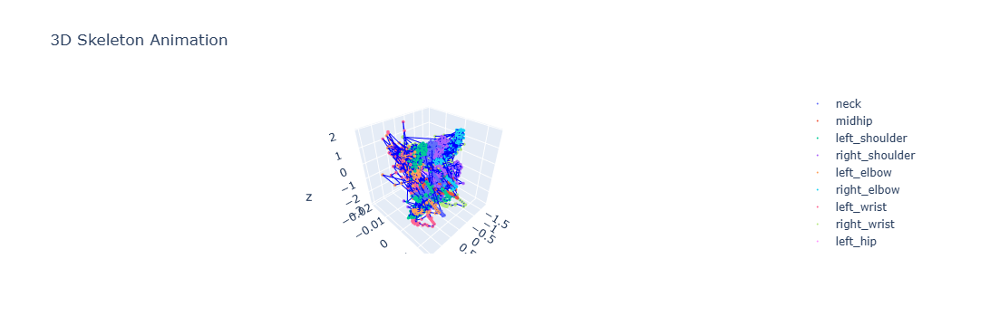

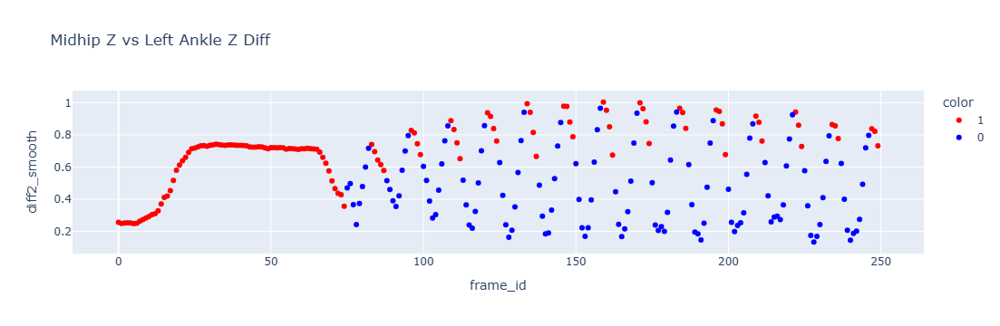

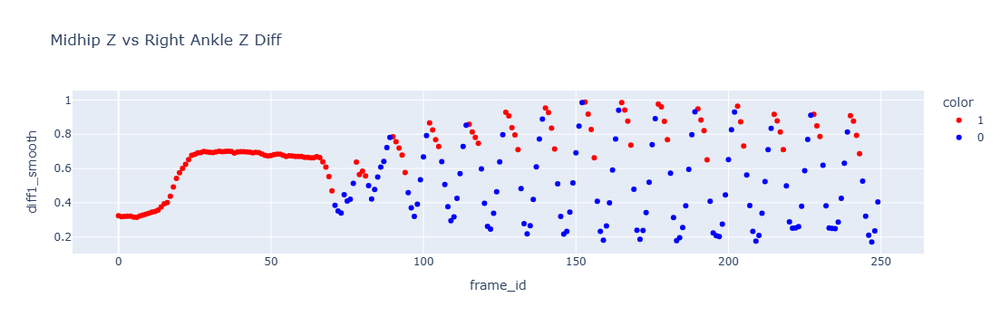

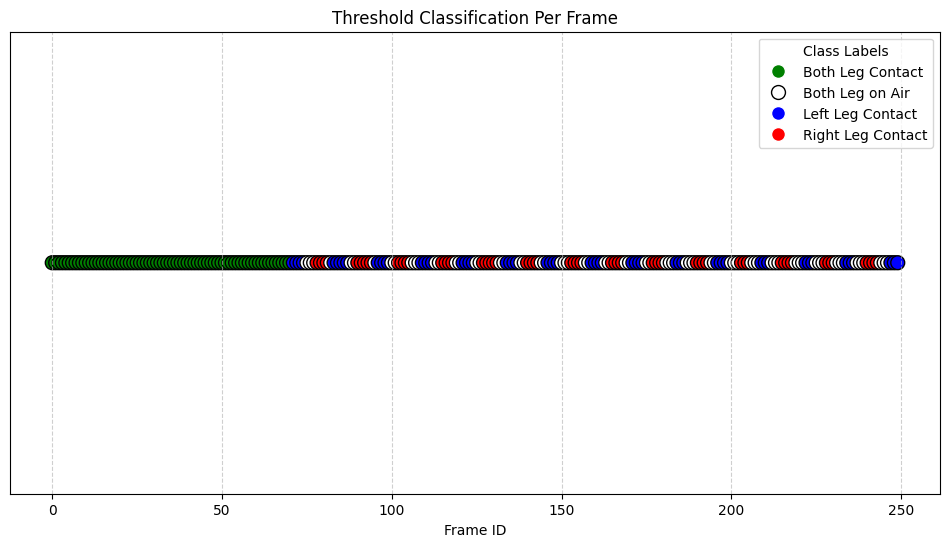

{'left': {'accuracy': 0.96, 'precision': 0.968503937007874, 'recall': 0.9534883720930233}, 'right': {'accuracy': 0.928, 'precision': 0.9212598425196851, 'recall': 0.936}}
leg_length_normalized 0.9877733848267756
Leg length at peak (normalized): 0.9878 → Scale factor: 0.9314


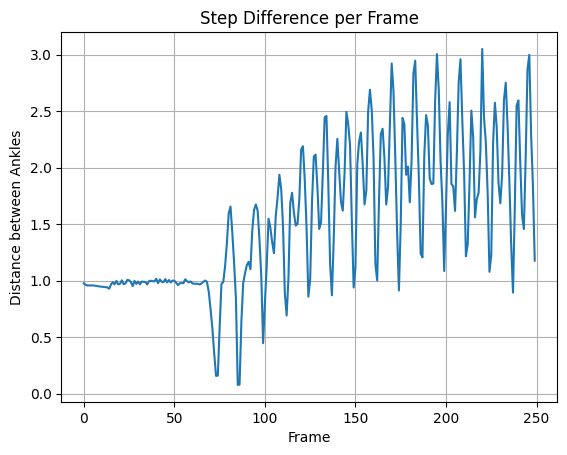

In [4]:
kenny_2 = SkeletonAnalyzerFineTune1("individual_lane_2.csv")
kenny_2.load_and_standardize()
kenny_2.rotate_coordinates()
kenny_2.compute_differences()
kenny_2.correct_outliers()
kenny_2.detect_dip_start()
kenny_2.classify_thresholds()
kenny_2.visualize_skeleton()
kenny_2.visualize_thresholds()
kenny_colors = kenny_2.plot_combined_leg_classification()
kenny_results = kenny_2.evaluate(individual_2_left, individual_2_right)
print(kenny_results)
kenny2_air, kenny2_contact = kenny_2.compute_contact_air_durations()
kenny = kenny_2.compute_step_rate()
kenny_step_rate = []
for i in kenny:
    kenny_step_rate.append(i['step_rate'])
kennyResult = kenny_2.compute_step_length()
kenny_scaling = float(kenny_2.estimate_scale_factor_from_leg_peak(real_leg_length_meters=0.92))
kenny_step_length = []
for i in kennyResult:
    i['max_distance'] *= kenny_scaling
    kenny_step_length.append(i['max_distance'])
kenny_2.compute_step_difference_per_frame()
kenny_speed = kenny_2.compute_speed()
kennyspeed = []
for i in kenny_speed:
    kennyspeed.append(i['speed_mps'])

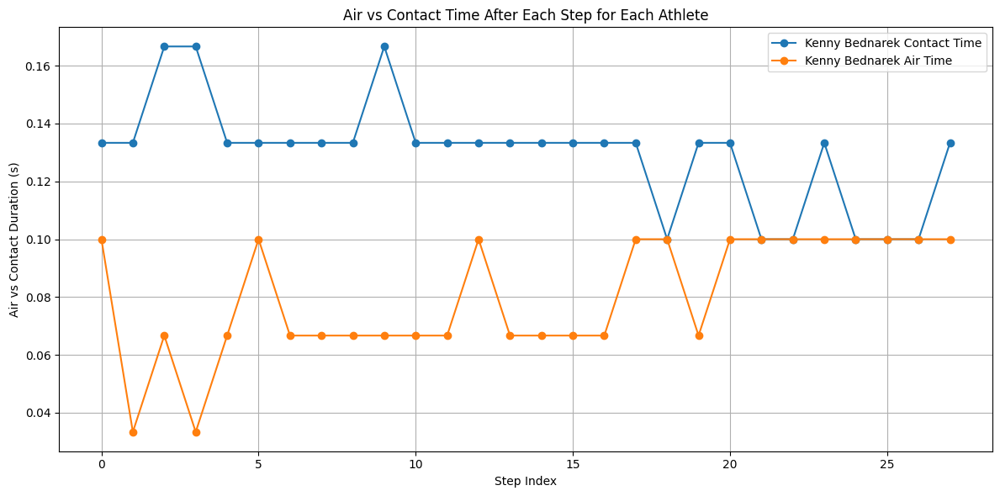

In [5]:
plt.figure(figsize=(12, 6))

plt.plot(kenny2_contact, label="Kenny Bednarek Contact Time", marker='o')
plt.plot(kenny2_air, label="Kenny Bednarek Air Time", marker='o')

plt.xlabel("Step Index")
plt.ylabel("Air vs Contact Duration (s)")
plt.title("Air vs Contact Time After Each Step for Each Athlete")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

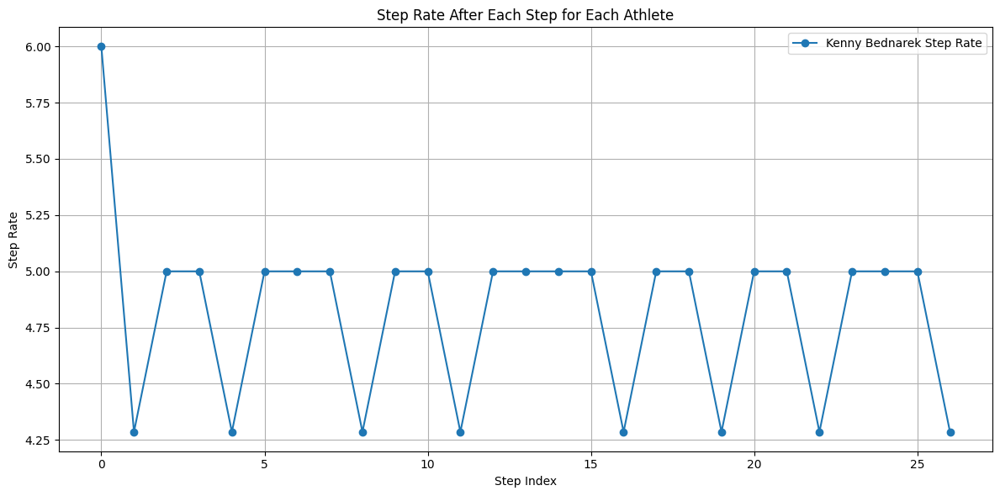

In [6]:
plt.figure(figsize=(12, 6))

plt.plot(kenny_step_rate, label="Kenny Bednarek Step Rate", marker='o')

plt.xlabel("Step Index")
plt.ylabel("Step Rate")
plt.title("Step Rate After Each Step for Each Athlete")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

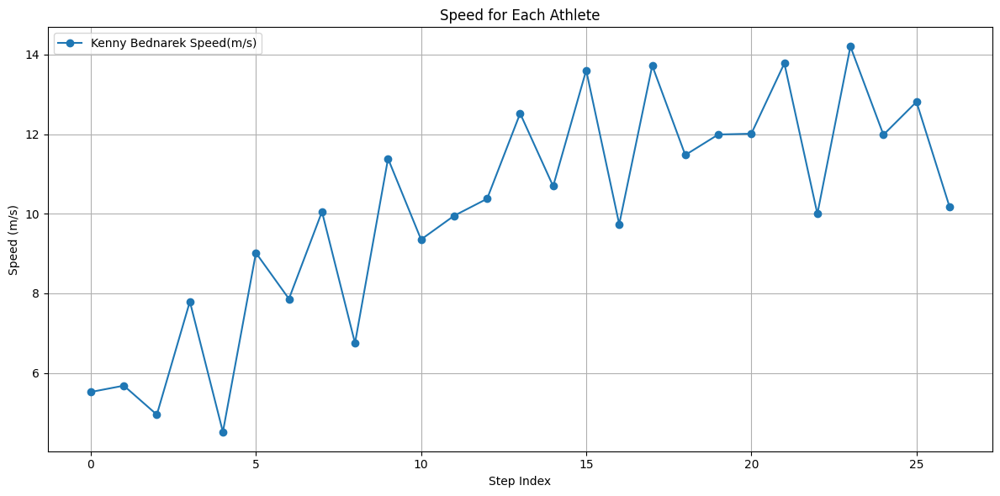

In [7]:
plt.figure(figsize=(12, 6))

plt.plot(kennyspeed, label="Kenny Bednarek Speed(m/s)", marker='o')

plt.xlabel("Step Index")
plt.ylabel("Speed (m/s)")
plt.title("Speed for Each Athlete")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

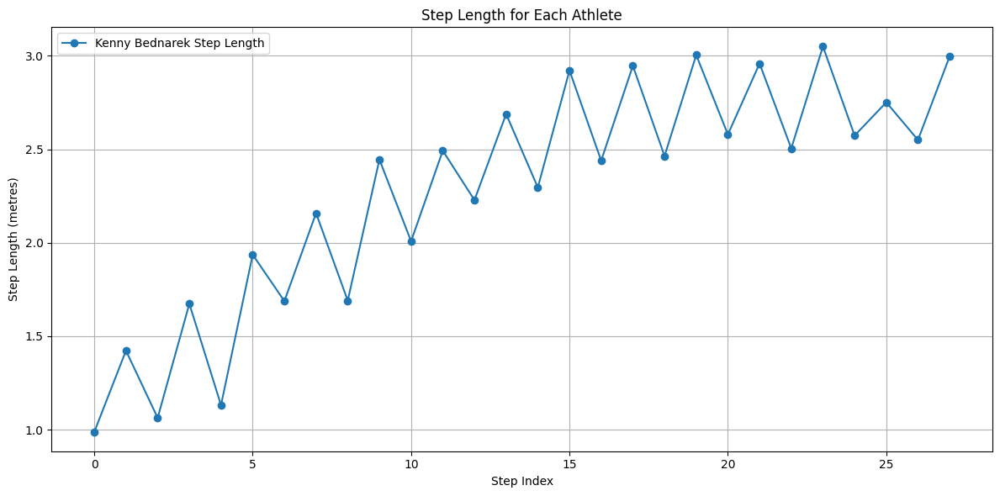

In [8]:
plt.figure(figsize=(12, 6))

plt.plot(kenny_step_length, label="Kenny Bednarek Step Length", marker='o')

plt.xlabel("Step Index")
plt.ylabel("Step Length (metres)")
plt.title("Step Length for Each Athlete")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

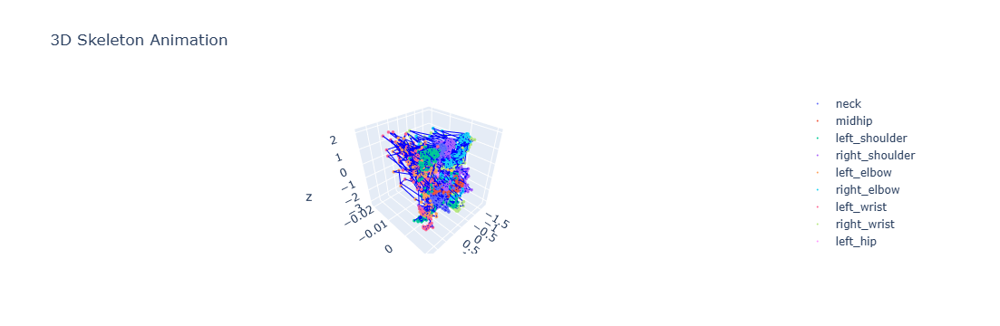

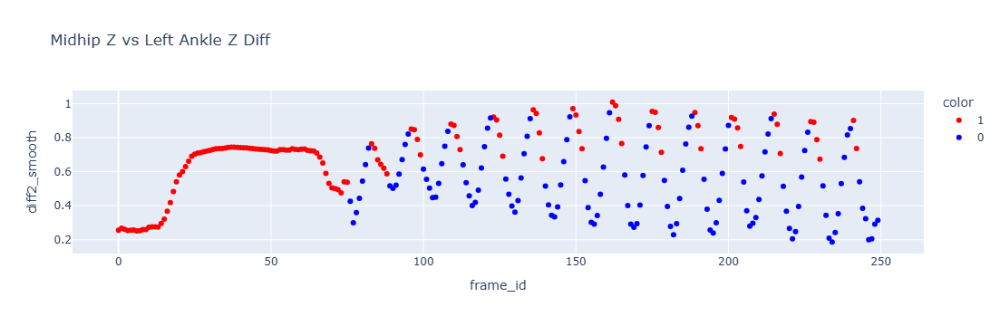

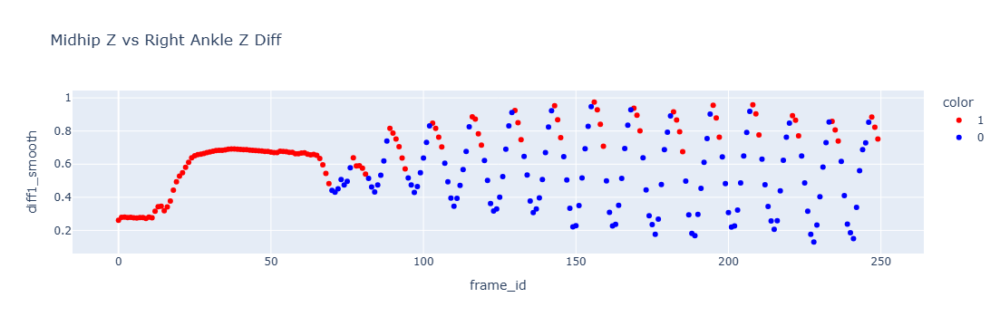

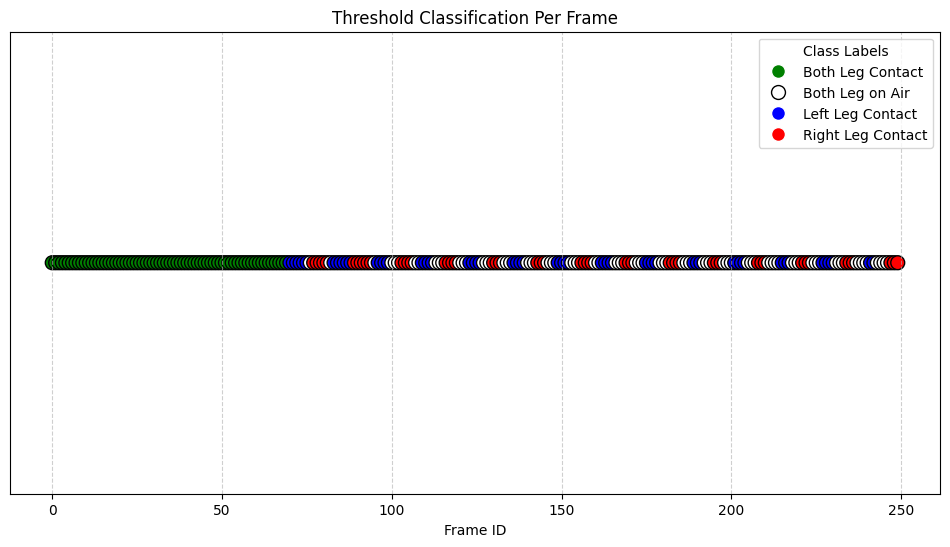

{'left': {'accuracy': 0.948, 'precision': 0.9365079365079365, 'recall': 0.959349593495935}, 'right': {'accuracy': 0.94, 'precision': 0.9421487603305785, 'recall': 0.9344262295081968}}
leg_length_normalized 0.9746527704616843
Leg length at peak (normalized): 0.9747 → Scale factor: 0.9850


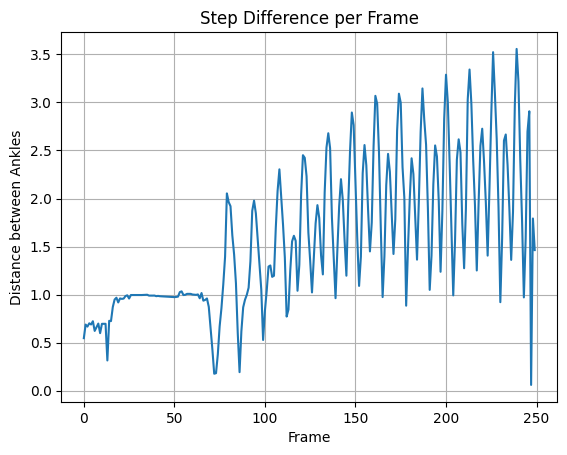

In [9]:
fred_3 = SkeletonAnalyzerFineTune1("individual_lane_3.csv")
fred_3.load_and_standardize()
fred_3.rotate_coordinates()
fred_3.compute_differences()
fred_3.correct_outliers()
fred_3.detect_dip_start()
fred_3.classify_thresholds()
fred_3.visualize_skeleton()
fred_3.visualize_thresholds()
fred_colors = fred_3.plot_combined_leg_classification()
fred_results = fred_3.evaluate(individual_3_left, individual_3_right)
print(fred_results)
fred3_air, fred3_contact = fred_3.compute_contact_air_durations()
fred = fred_3.compute_step_rate()
fred_step_rate = []
for i in fred:
    fred_step_rate.append(i['step_rate'])
fredResult = fred_3.compute_step_length()
fred_scaling = float(fred_3.estimate_scale_factor_from_leg_peak(real_leg_length_meters=0.96))
fred_step_length = []
for i in fredResult:
    i['max_distance'] *= fred_scaling
    fred_step_length.append(i['max_distance'])
fred_3.compute_step_difference_per_frame()
fred_speed = fred_3.compute_speed()
fredspeed = []
for i in fred_speed:
    fredspeed.append(i['speed_mps'])

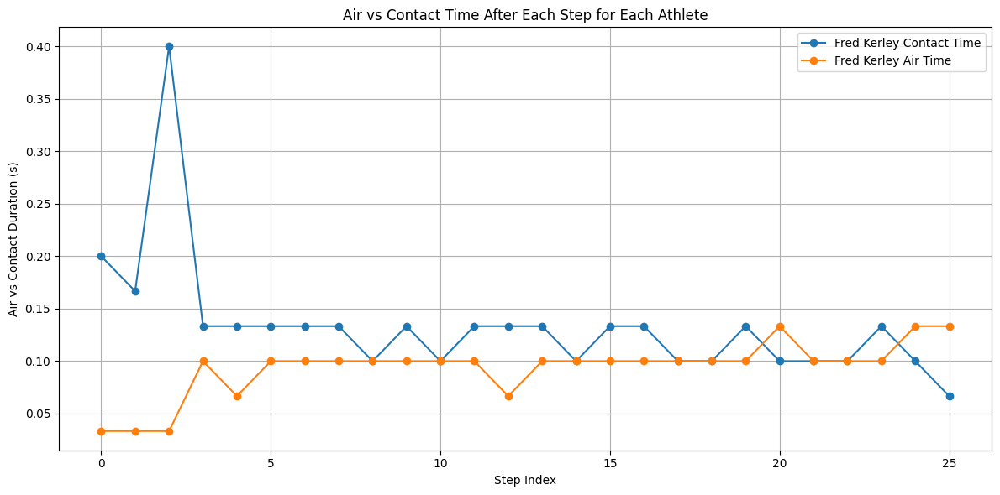

In [10]:
plt.figure(figsize=(12, 6))

plt.plot(fred3_contact, label="Fred Kerley Contact Time", marker='o')
plt.plot(fred3_air, label="Fred Kerley Air Time", marker='o')

plt.xlabel("Step Index")
plt.ylabel("Air vs Contact Duration (s)")
plt.title("Air vs Contact Time After Each Step for Each Athlete")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

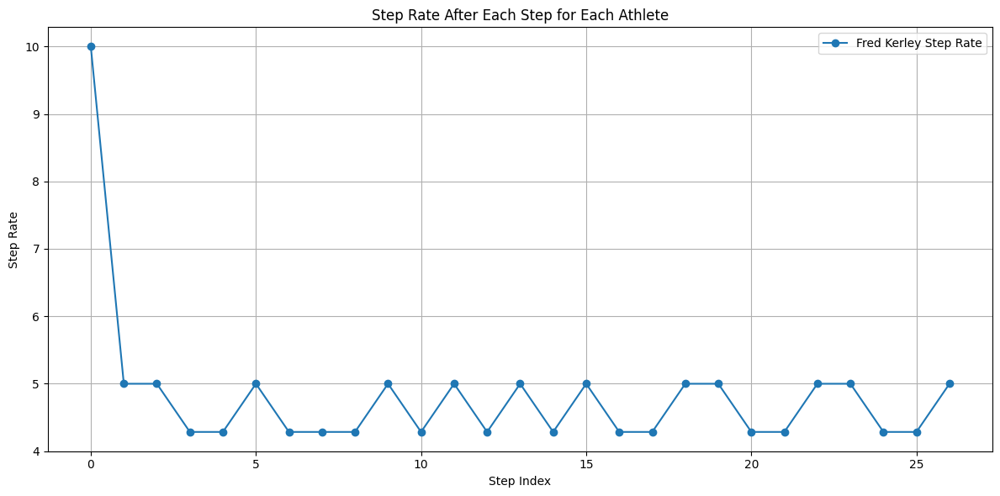

In [11]:
plt.figure(figsize=(12, 6))

plt.plot(fred_step_rate, label="Fred Kerley Step Rate", marker='o')

plt.xlabel("Step Index")
plt.ylabel("Step Rate")
plt.title("Step Rate After Each Step for Each Athlete")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

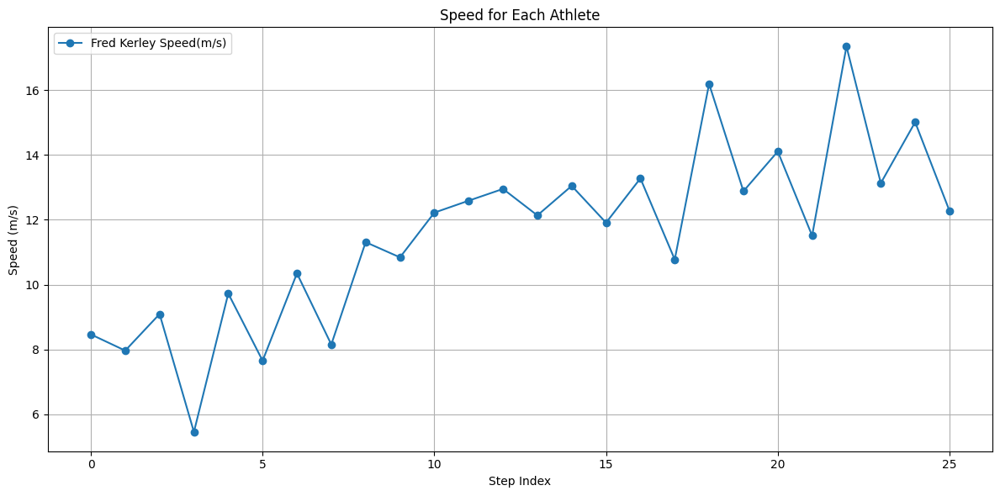

In [12]:
plt.figure(figsize=(12, 6))

plt.plot(fredspeed, label="Fred Kerley Speed(m/s)", marker='o')

plt.xlabel("Step Index")
plt.ylabel("Speed (m/s)")
plt.title("Speed for Each Athlete")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

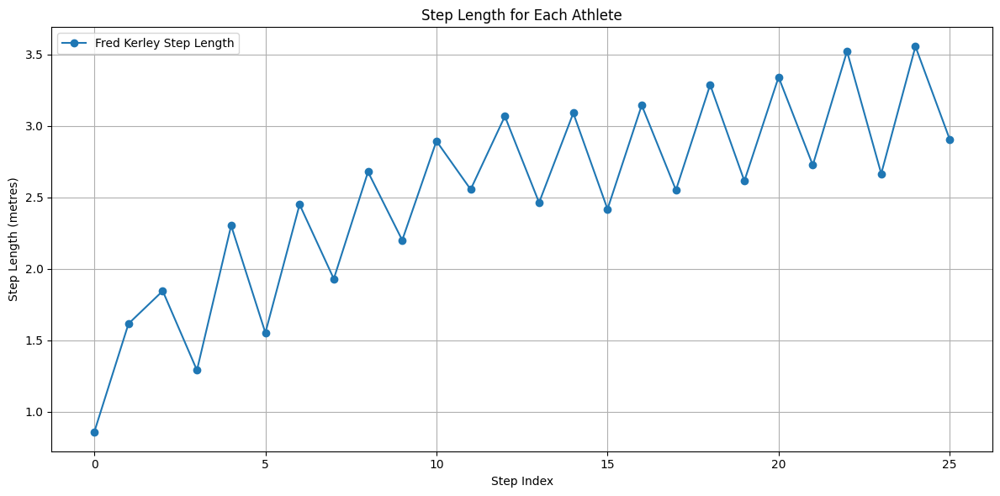

In [13]:
plt.figure(figsize=(12, 6))

plt.plot(fred_step_length, label="Fred Kerley Step Length", marker='o')

plt.xlabel("Step Index")
plt.ylabel("Step Length (metres)")
plt.title("Step Length for Each Athlete")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

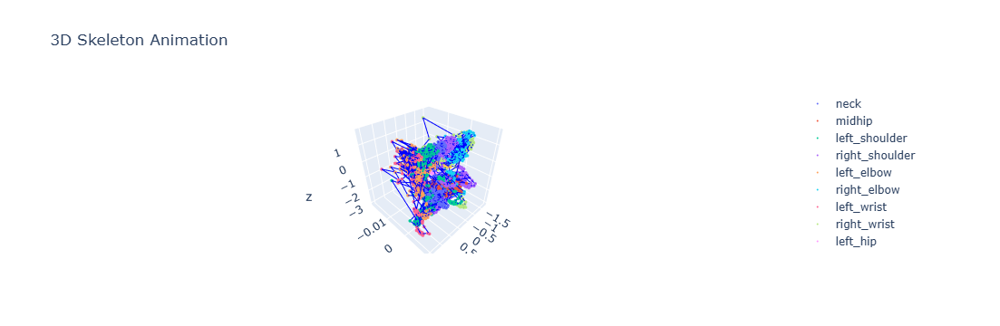

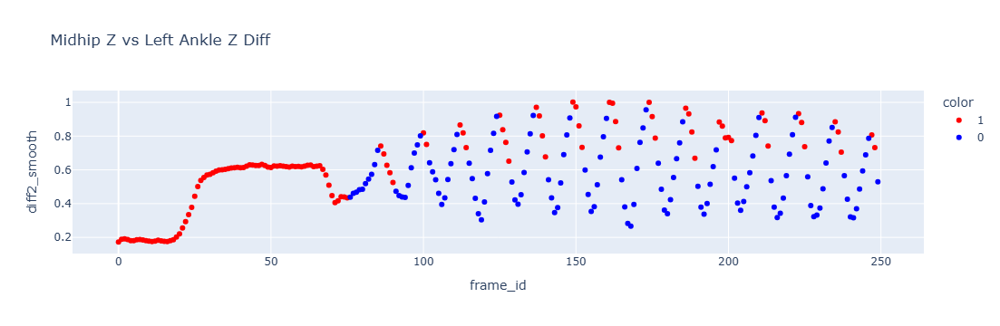

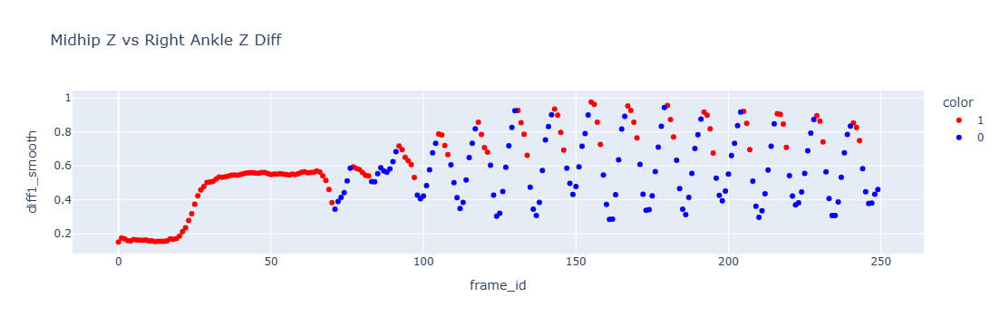

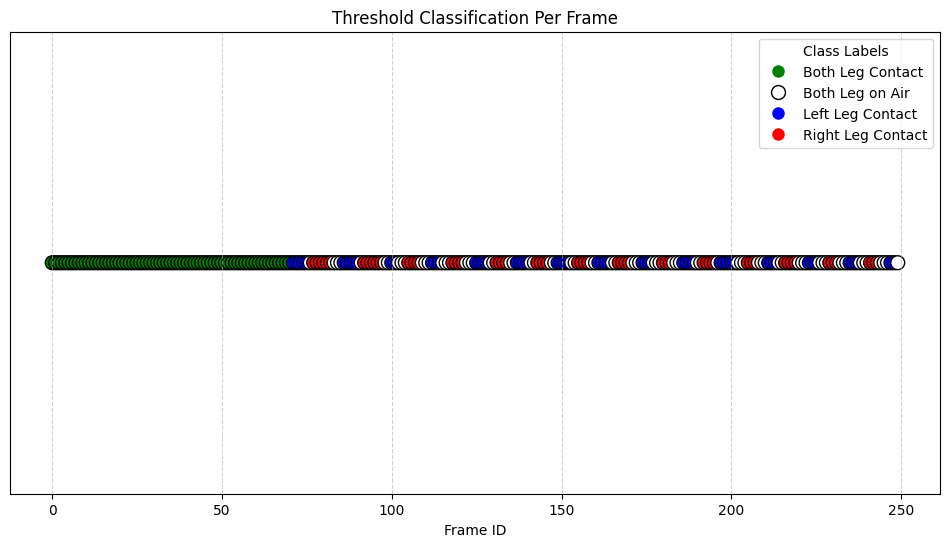

{'left': {'accuracy': 0.948, 'precision': 0.952, 'recall': 0.9444444444444444}, 'right': {'accuracy': 0.936, 'precision': 0.9212598425196851, 'recall': 0.9512195121951219}}
leg_length_normalized 0.9761718735016058
Leg length at peak (normalized): 0.9762 → Scale factor: 0.9322


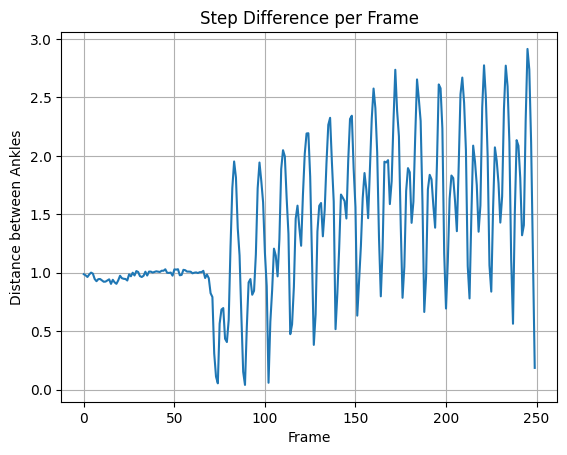

In [14]:
kishane_4 = SkeletonAnalyzerFineTune1("individual_lane_4.csv")
kishane_4.load_and_standardize()
kishane_4.rotate_coordinates()
kishane_4.compute_differences()
kishane_4.correct_outliers()
kishane_4.detect_dip_start()
kishane_4.classify_thresholds()
kishane_4.visualize_skeleton()
kishane_4.visualize_thresholds()
kishane_colors = kishane_4.plot_combined_leg_classification()
kishane_results = kishane_4.evaluate(individual_4_left, individual_4_right)
print(kishane_results)
kishane4_air, kishane4_contact = kishane_4.compute_contact_air_durations()
kishane4 = kishane_4.compute_step_rate()
kishane_step_rate = []
for i in kishane4:
    kishane_step_rate.append(i['step_rate'])
kishane_step_length = []
kishaneResult = kishane_4.compute_step_length()
kishane_scaling = float(kishane_4.estimate_scale_factor_from_leg_peak(real_leg_length_meters=0.91))
for i in kishaneResult:
    i['max_distance'] *= kishane_scaling
    kishane_step_length.append(i['max_distance'])
kishane_4.compute_step_difference_per_frame()
kishane_speed = kishane_4.compute_speed()
kishanespeed = []
for i in kishane_speed:
    kishanespeed.append(i['speed_mps'])

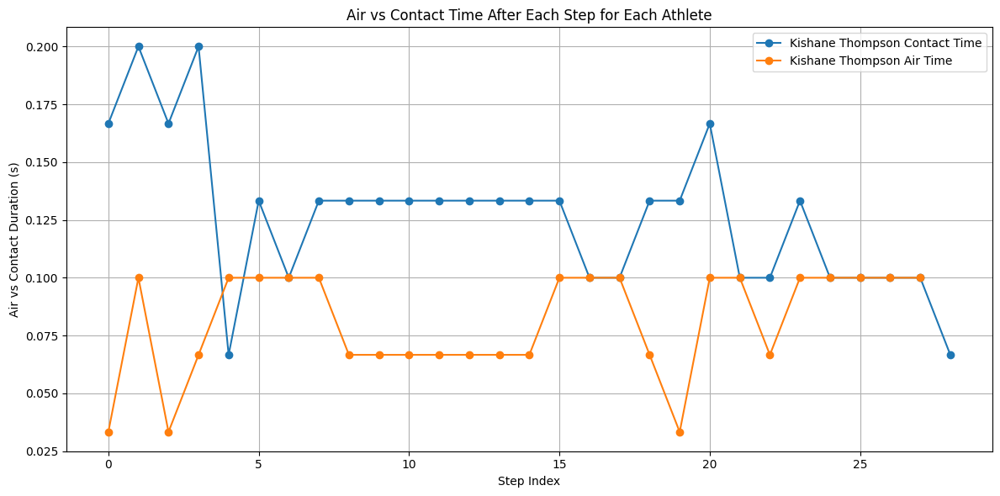

In [15]:
plt.figure(figsize=(12, 6))

plt.plot(kishane4_contact, label="Kishane Thompson Contact Time", marker='o')
plt.plot(kishane4_air, label="Kishane Thompson Air Time", marker='o')

plt.xlabel("Step Index")
plt.ylabel("Air vs Contact Duration (s)")
plt.title("Air vs Contact Time After Each Step for Each Athlete")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

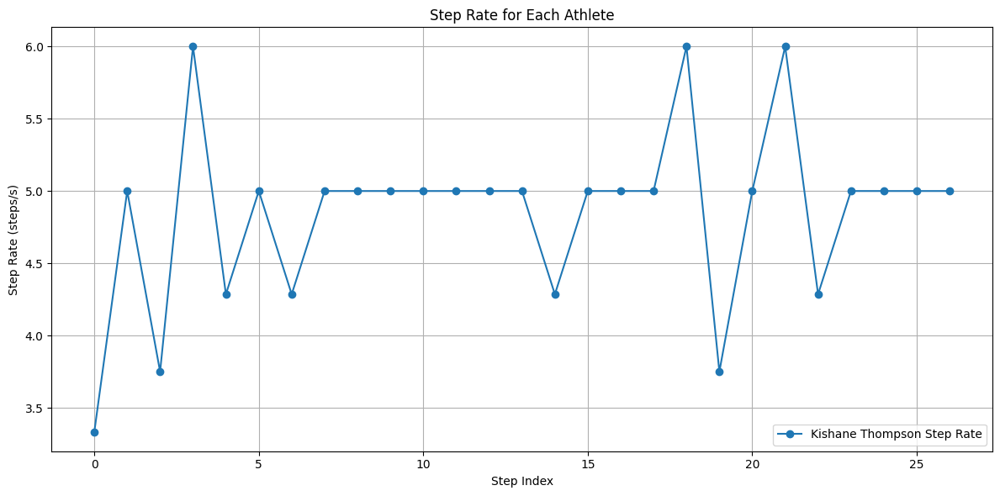

In [16]:
plt.figure(figsize=(12, 6))

plt.plot(kishane_step_rate, label="Kishane Thompson Step Rate", marker='o')

plt.xlabel("Step Index")
plt.ylabel("Step Rate (steps/s)")
plt.title("Step Rate for Each Athlete")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

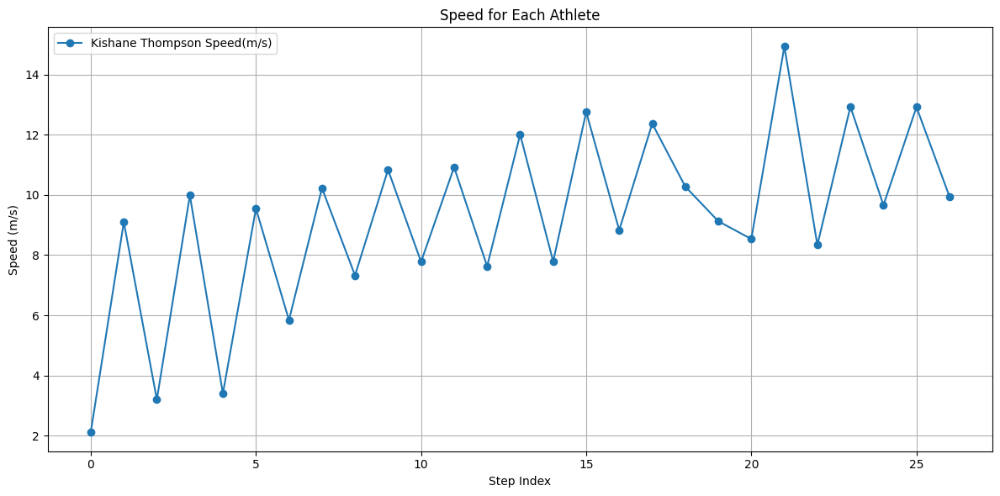

In [17]:
plt.figure(figsize=(12, 6))

plt.plot(kishanespeed, label="Kishane Thompson Speed(m/s)", marker='o')

plt.xlabel("Step Index")
plt.ylabel("Speed (m/s)")
plt.title("Speed for Each Athlete")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

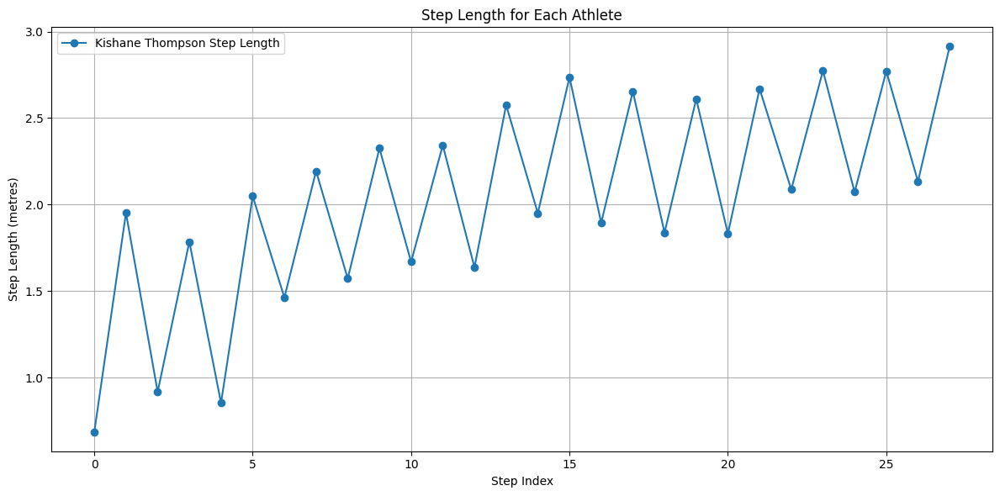

In [18]:
plt.figure(figsize=(12, 6))

plt.plot(kishane_step_length, label="Kishane Thompson Step Length", marker='o')

plt.xlabel("Step Index")
plt.ylabel("Step Length (metres)")
plt.title("Step Length for Each Athlete")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

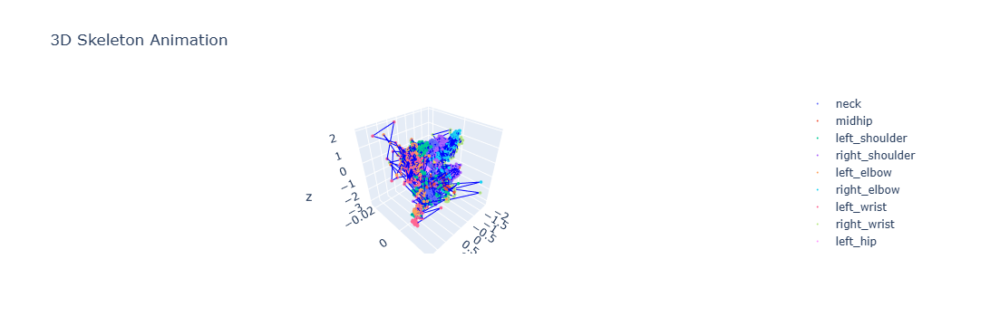

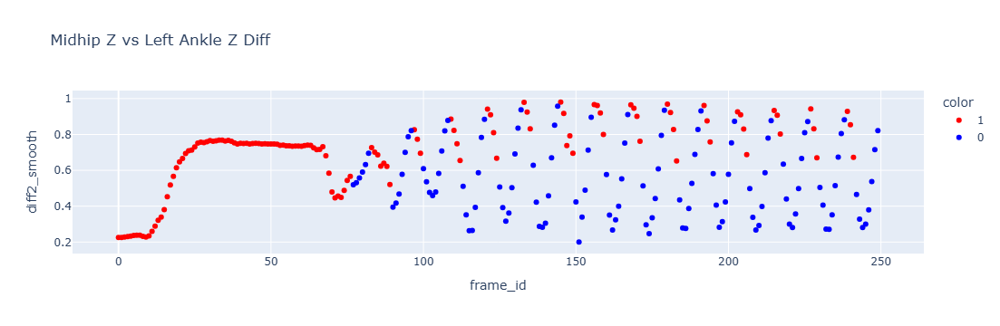

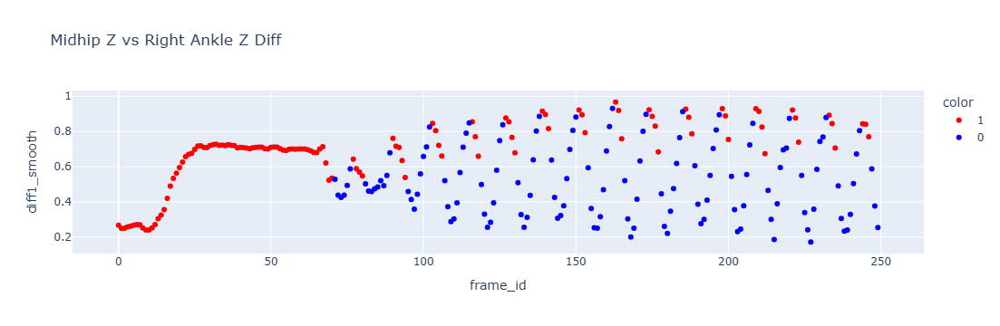

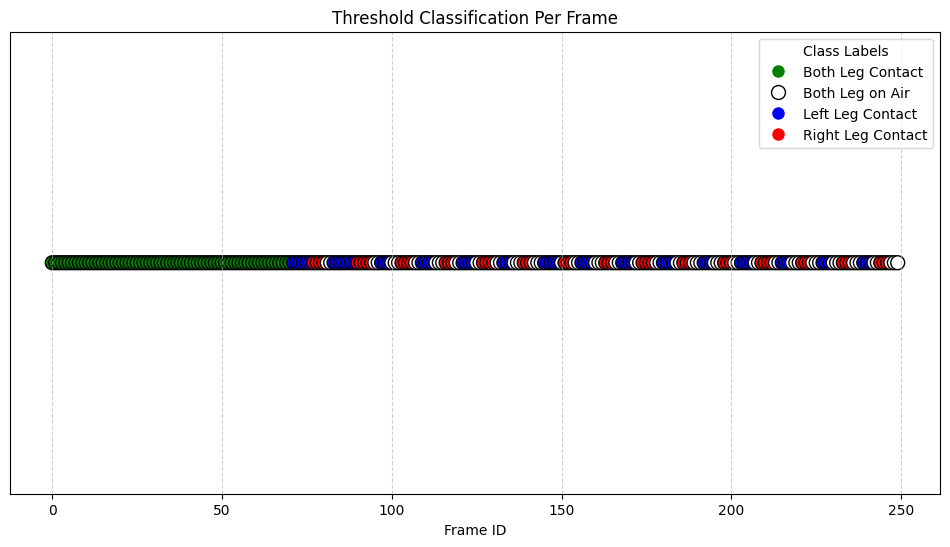

{'left': {'accuracy': 0.94, 'precision': 0.916030534351145, 'recall': 0.967741935483871}, 'right': {'accuracy': 0.96, 'precision': 0.967479674796748, 'recall': 0.952}}
leg_length_normalized 0.966575088659462
Leg length at peak (normalized): 0.9666 → Scale factor: 0.8484


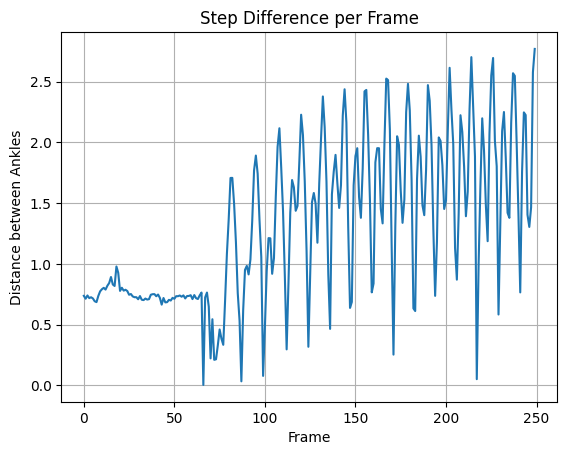

In [19]:
akani_5 = SkeletonAnalyzerFineTune1("individual_lane_5.csv")
akani_5.load_and_standardize()
akani_5.rotate_coordinates()
akani_5.compute_differences()
akani_5.correct_outliers()
akani_5.detect_dip_start()
akani_5.classify_thresholds()
akani_5.visualize_skeleton()
akani_5.visualize_thresholds()
akani_colors = akani_5.plot_combined_leg_classification()
akani_results = akani_5.evaluate(individual_5_left, individual_5_right)
print(akani_results)
akani5_air, akani5_contact = akani_5.compute_contact_air_durations()
akani = akani_5.compute_step_rate()
akani_step_rate = []
for i in akani:
    akani_step_rate.append(i['step_rate'])
akani_step_length = []
akaniResult = akani_5.compute_step_length()
akani_scaling = float(akani_5.estimate_scale_factor_from_leg_peak(real_leg_length_meters=0.82))
for i in akaniResult:
    i['max_distance'] *= akani_scaling
    akani_step_length.append(i['max_distance'])
akani_5.compute_step_difference_per_frame()
akani_speed = akani_5.compute_speed()
akanispeed = []
for i in akani_speed:
    akanispeed.append(i['speed_mps'])

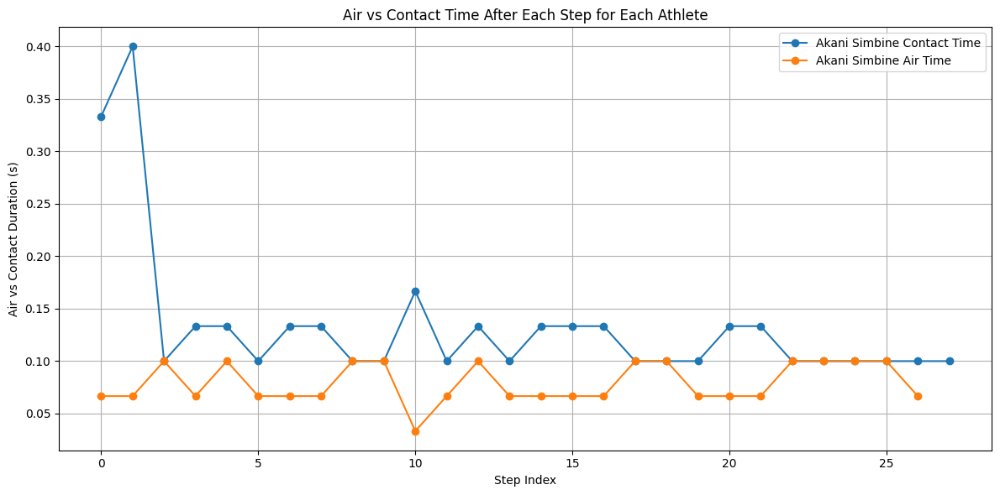

In [20]:
plt.figure(figsize=(12, 6))

plt.plot(akani5_contact, label="Akani Simbine Contact Time", marker='o')
plt.plot(akani5_air, label="Akani Simbine Air Time", marker='o')

plt.xlabel("Step Index")
plt.ylabel("Air vs Contact Duration (s)")
plt.title("Air vs Contact Time After Each Step for Each Athlete")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

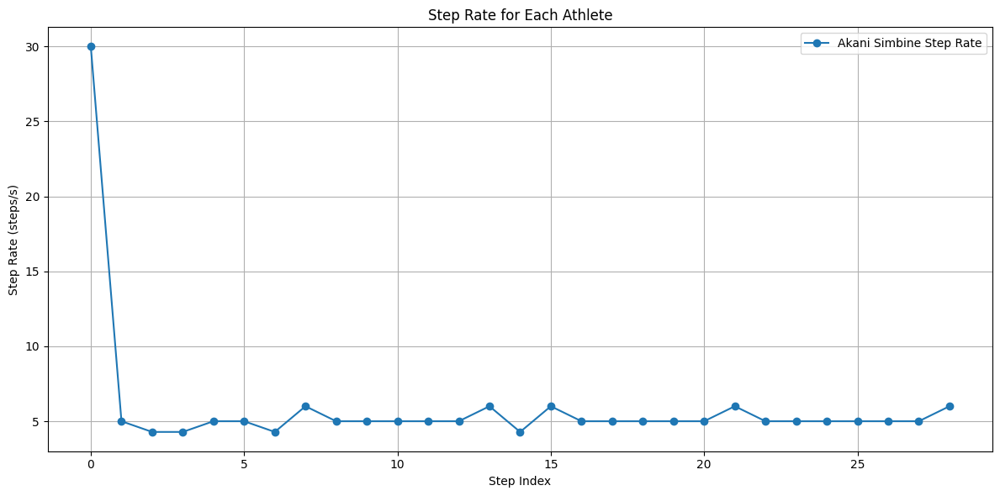

In [21]:
plt.figure(figsize=(12, 6))

plt.plot(akani_step_rate, label="Akani Simbine Step Rate", marker='o')

plt.xlabel("Step Index")
plt.ylabel("Step Rate (steps/s)")
plt.title("Step Rate for Each Athlete")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

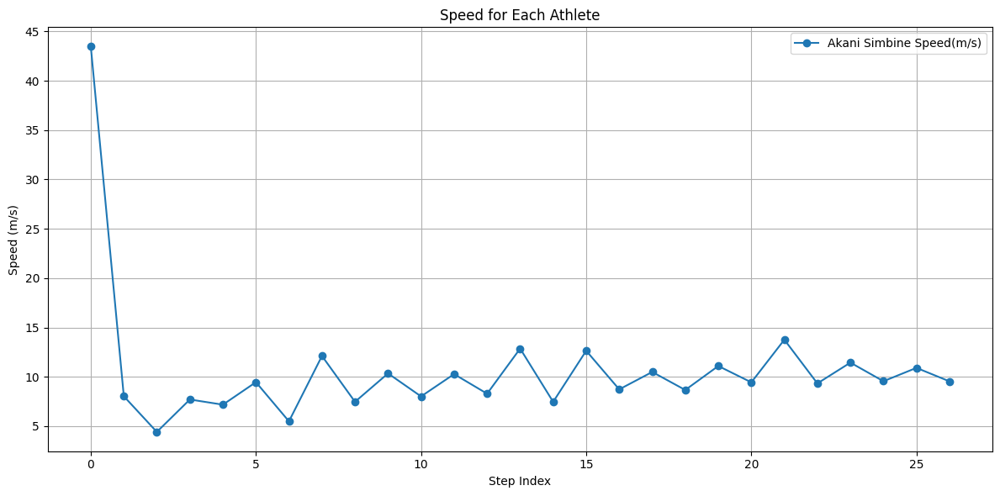

In [22]:
plt.figure(figsize=(12, 6))

plt.plot(akanispeed, label="Akani Simbine Speed(m/s)", marker='o')

plt.xlabel("Step Index")
plt.ylabel("Speed (m/s)")
plt.title("Speed for Each Athlete")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

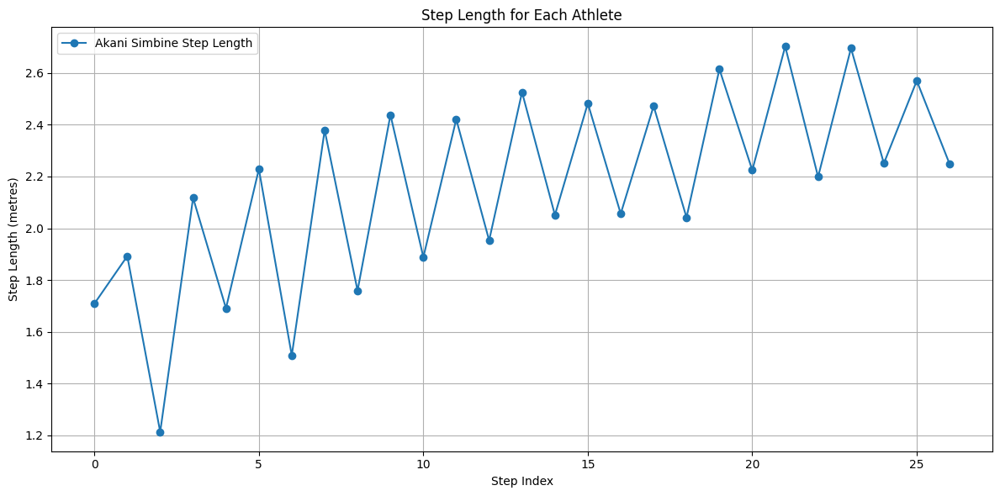

In [23]:
plt.figure(figsize=(12, 6))

plt.plot(akani_step_length, label="Akani Simbine Step Length", marker='o')

plt.xlabel("Step Index")
plt.ylabel("Step Length (metres)")
plt.title("Step Length for Each Athlete")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

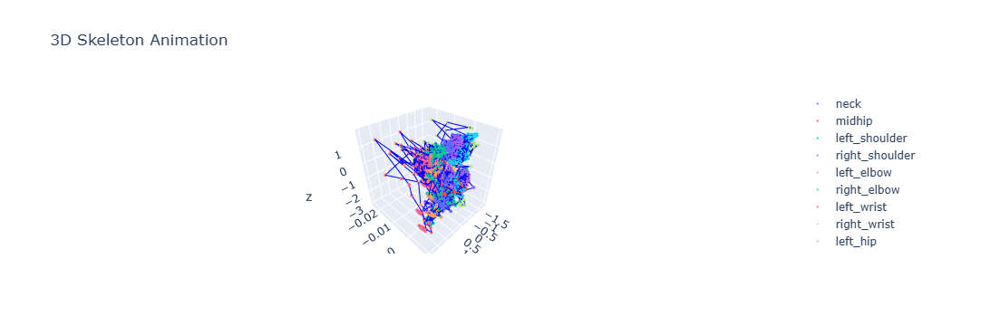

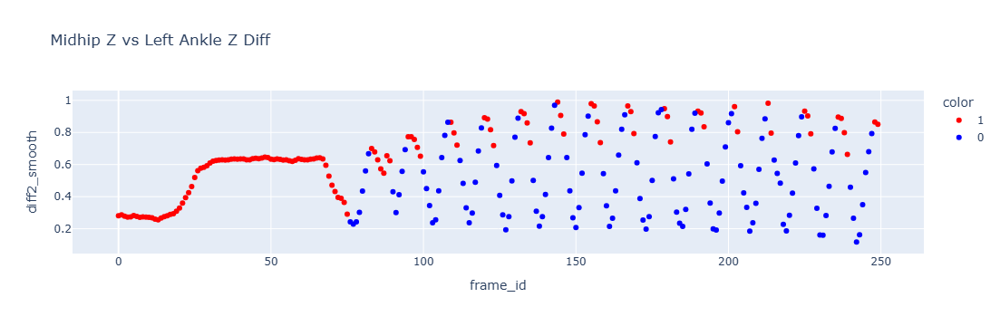

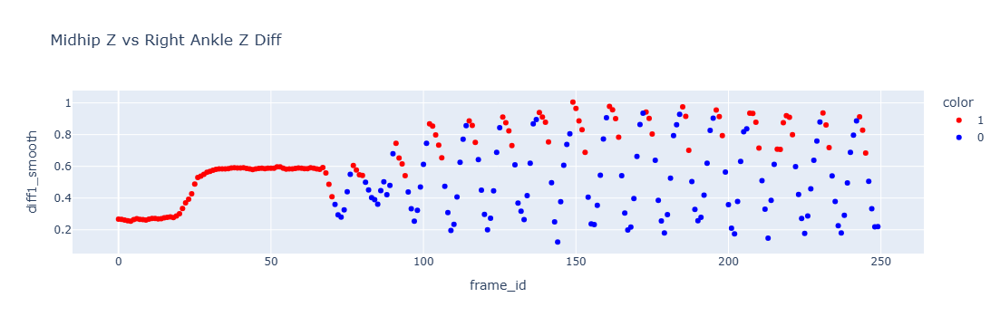

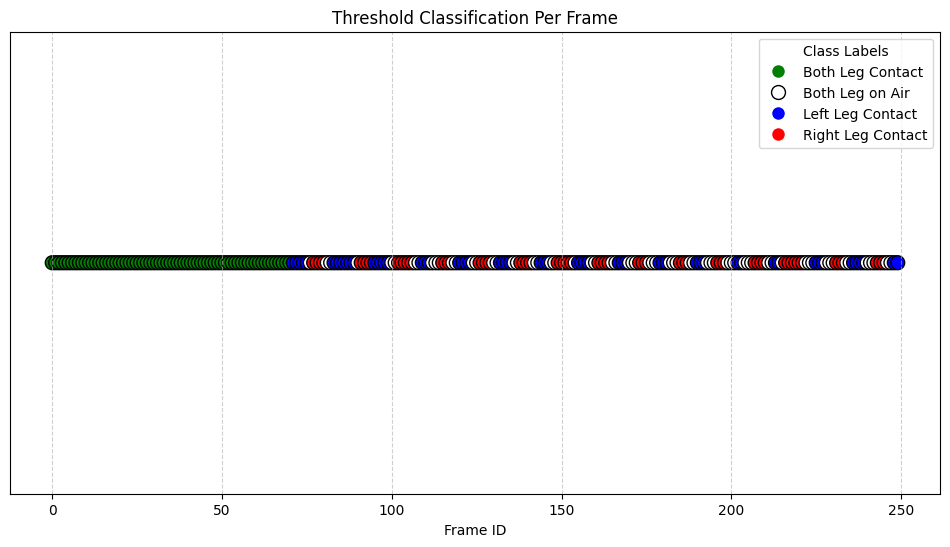

{'left': {'accuracy': 0.912, 'precision': 0.9140625, 'recall': 0.9140625}, 'right': {'accuracy': 0.94, 'precision': 0.9224806201550387, 'recall': 0.9596774193548387}}
leg_length_normalized 1.0049996766624463
Leg length at peak (normalized): 1.0050 → Scale factor: 0.7463


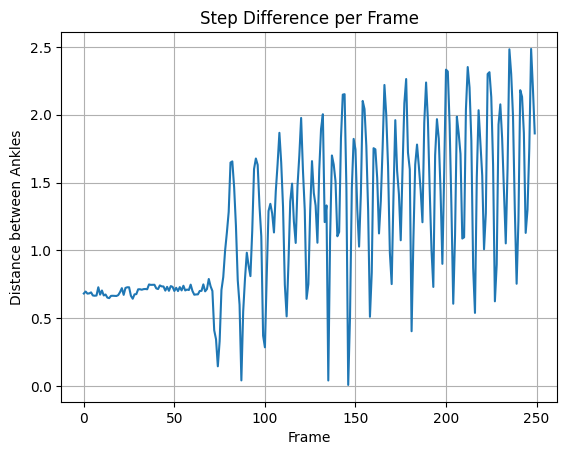

In [24]:
oblique_6 = SkeletonAnalyzerFineTune1("individual_lane_6.csv")
oblique_6.load_and_standardize()
oblique_6.rotate_coordinates()
oblique_6.compute_differences()
oblique_6.correct_outliers()
oblique_6.detect_dip_start()
oblique_6.classify_thresholds()
oblique_6.visualize_skeleton()
oblique_6.visualize_thresholds()
oblique_colors = oblique_6.plot_combined_leg_classification()
oblique_results = oblique_6.evaluate(individual_6_left, individual_6_right)
print(oblique_results)
oblique6_air, oblique6_contact = oblique_6.compute_contact_air_durations()
oblique = oblique_6.compute_step_rate()
oblique_step_rate = []
for i in oblique:
    oblique_step_rate.append(i['step_rate'])
oblique_step_length = []
obliqueResult = oblique_6.compute_step_length()
oblique_scaling = float(oblique_6.estimate_scale_factor_from_leg_peak(real_leg_length_meters=0.75))
for i in obliqueResult:
    i['max_distance'] *= oblique_scaling
    oblique_step_length.append(i['max_distance'])
oblique_6.compute_step_difference_per_frame()
oblique_speed = oblique_6.compute_speed()
obliquespeed = []
for i in oblique_speed:
    obliquespeed.append(i['speed_mps'])

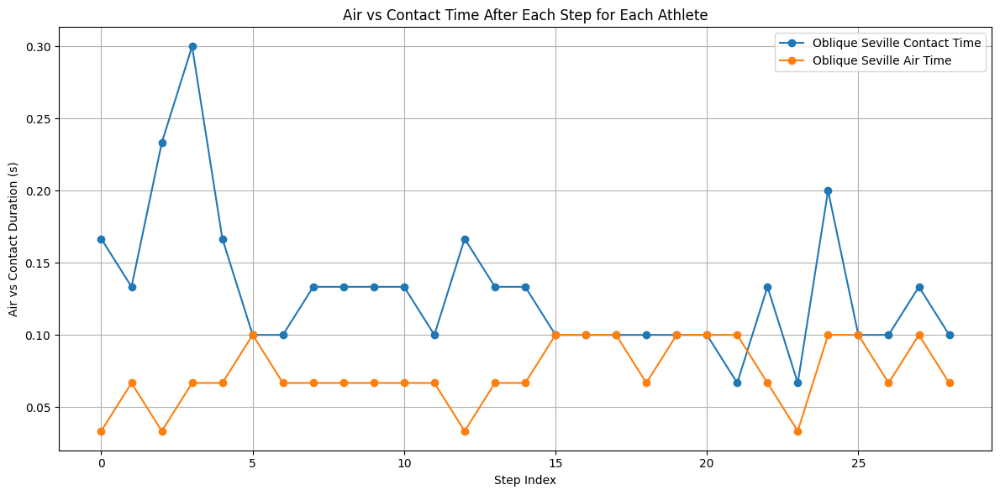

In [25]:
plt.figure(figsize=(12, 6))

plt.plot(oblique6_contact, label="Oblique Seville Contact Time", marker='o')
plt.plot(oblique6_air, label="Oblique Seville Air Time", marker='o')

plt.xlabel("Step Index")
plt.ylabel("Air vs Contact Duration (s)")
plt.title("Air vs Contact Time After Each Step for Each Athlete")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

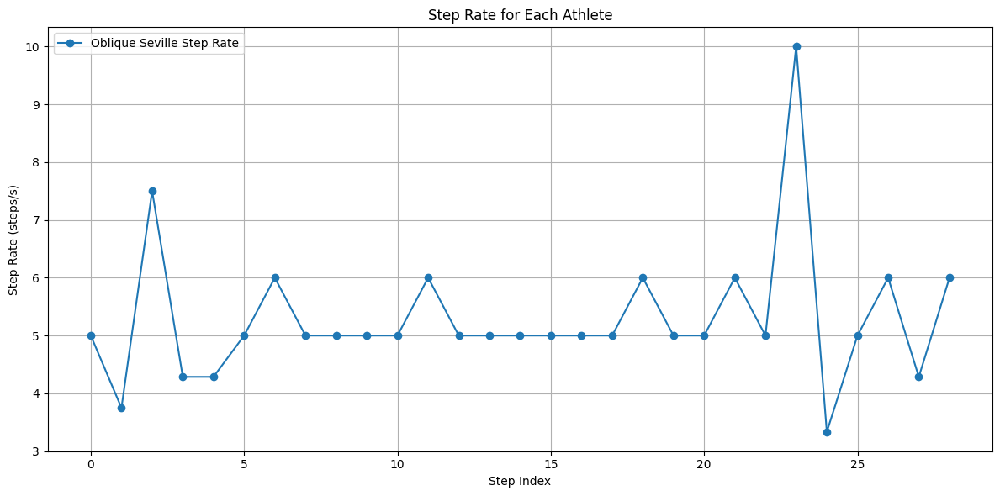

In [26]:
plt.figure(figsize=(12, 6))

plt.plot(oblique_step_rate, label="Oblique Seville Step Rate", marker='o')

plt.xlabel("Step Index")
plt.ylabel("Step Rate (steps/s)")
plt.title("Step Rate for Each Athlete")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

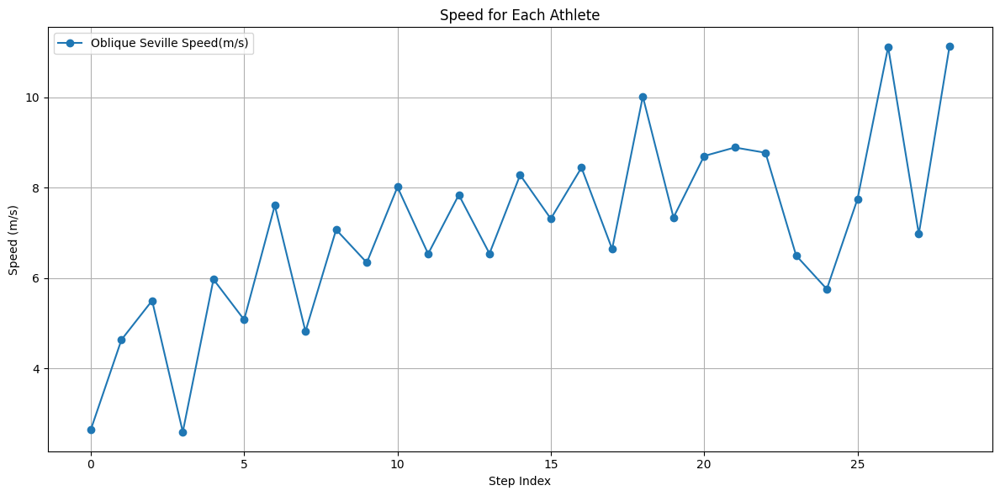

In [27]:
plt.figure(figsize=(12, 6))

plt.plot(obliquespeed, label="Oblique Seville Speed(m/s)", marker='o')

plt.xlabel("Step Index")
plt.ylabel("Speed (m/s)")
plt.title("Speed for Each Athlete")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

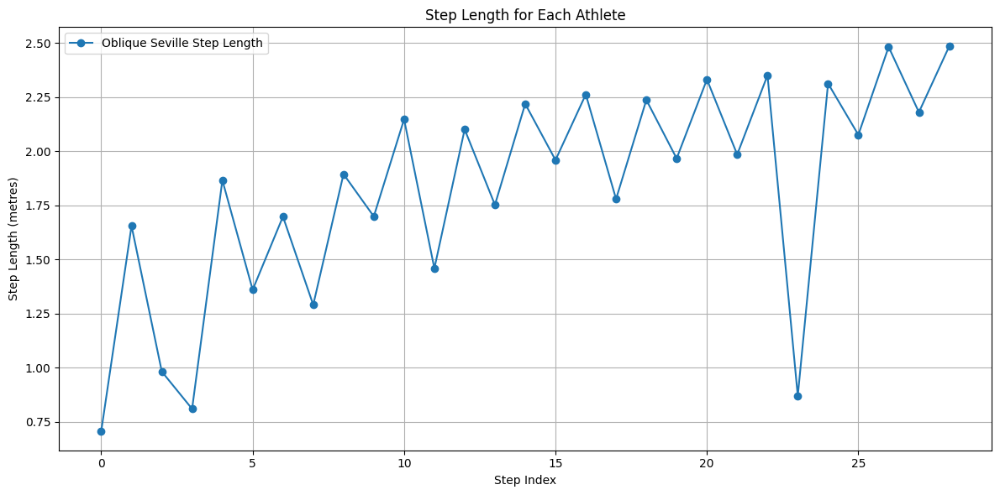

In [28]:
plt.figure(figsize=(12, 6))

plt.plot(oblique_step_length, label="Oblique Seville Step Length", marker='o')

plt.xlabel("Step Index")
plt.ylabel("Step Length (metres)")
plt.title("Step Length for Each Athlete")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

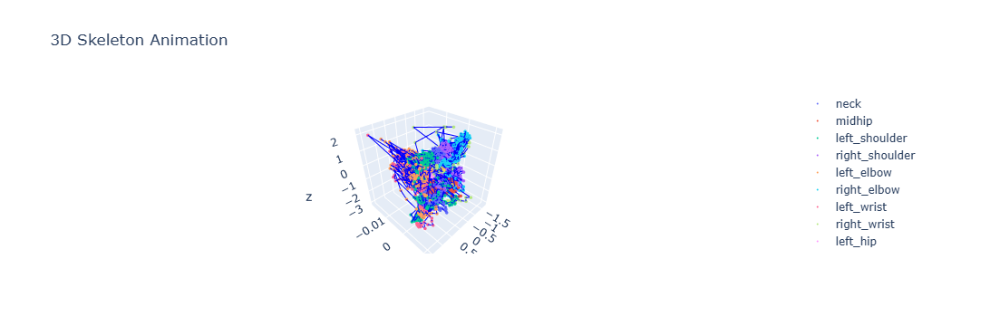

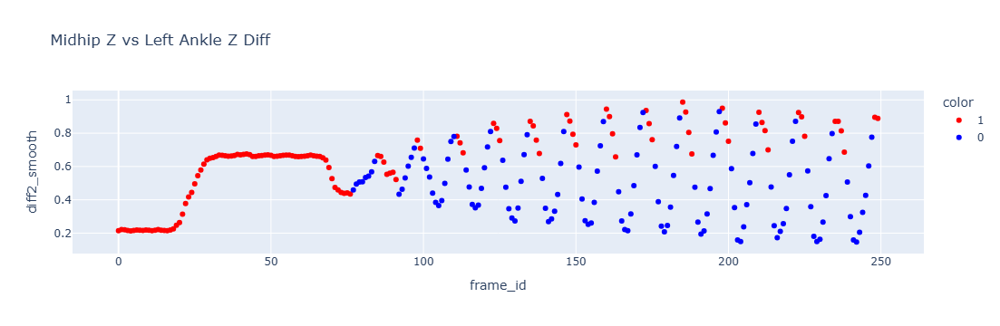

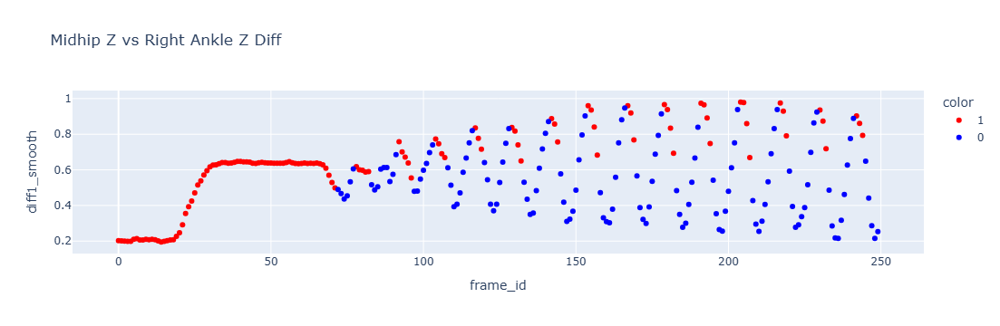

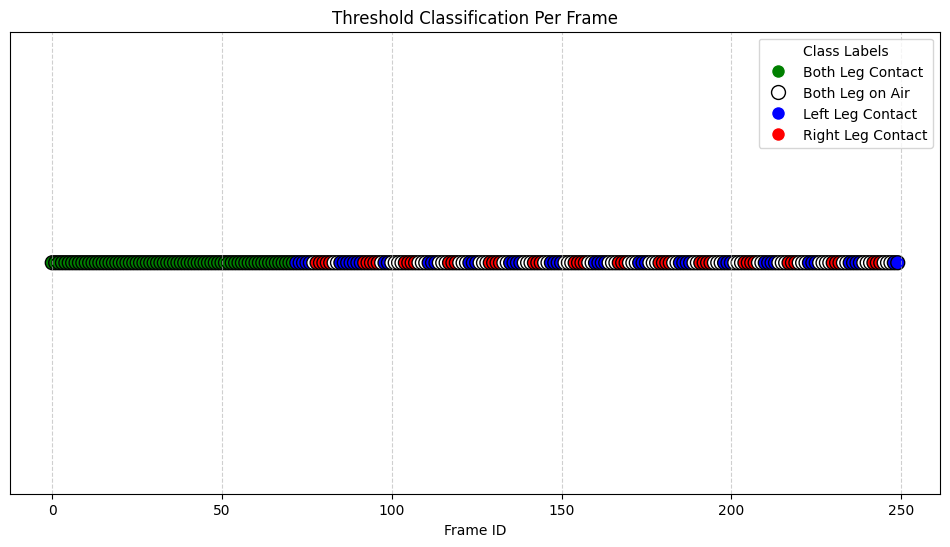

{'left': {'accuracy': 0.94, 'precision': 0.937007874015748, 'recall': 0.9444444444444444}, 'right': {'accuracy': 0.952, 'precision': 0.9596774193548387, 'recall': 0.9444444444444444}}
leg_length_normalized 0.9803919302227757
Leg length at peak (normalized): 0.9804 → Scale factor: 0.8772


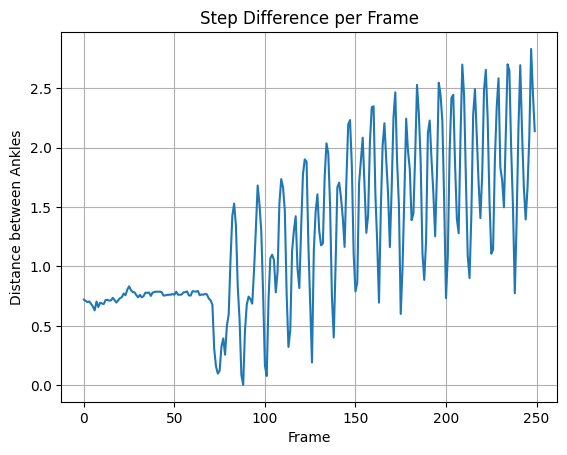

In [29]:
noah_7 = SkeletonAnalyzerFineTune1("individual_lane_7.csv")
noah_7.load_and_standardize()
noah_7.rotate_coordinates()
noah_7.compute_differences()
noah_7.correct_outliers()
noah_7.detect_dip_start()
noah_7.classify_thresholds()
noah_7.visualize_skeleton()
noah_7.visualize_thresholds()
noah_colors = noah_7.plot_combined_leg_classification()
noah_results = noah_7.evaluate(individual_7_left, individual_7_right)
print(noah_results)
noah7_air, noah7_contact = noah_7.compute_contact_air_durations()
noah = noah_7.compute_step_rate()
noah_step_rate = []
for i in noah:
    noah_step_rate.append(i['step_rate'])
noah_step_length = []
noahResult = noah_7.compute_step_length()
noah_scaling = float(noah_7.estimate_scale_factor_from_leg_peak())
for i in noahResult:
    i['max_distance'] *= noah_scaling
    noah_step_length.append(i['max_distance'])
noah_7.compute_step_difference_per_frame()
noah_speed = noah_7.compute_speed()
noahspeed = []
for i in noah_speed:
    noahspeed.append(i['speed_mps'])

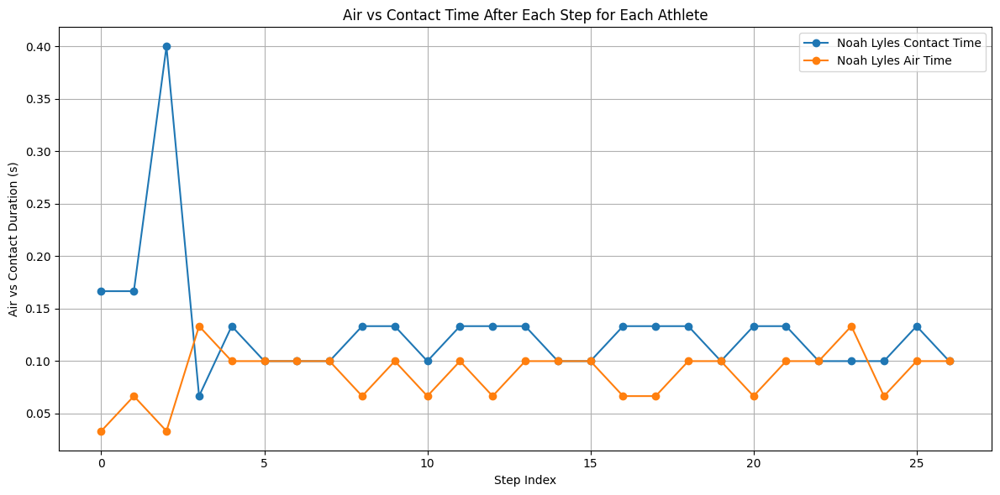

In [30]:
plt.figure(figsize=(12, 6))

plt.plot(noah7_contact, label="Noah Lyles Contact Time", marker='o')
plt.plot(noah7_air, label="Noah Lyles Air Time", marker='o')

plt.xlabel("Step Index")
plt.ylabel("Air vs Contact Duration (s)")
plt.title("Air vs Contact Time After Each Step for Each Athlete")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

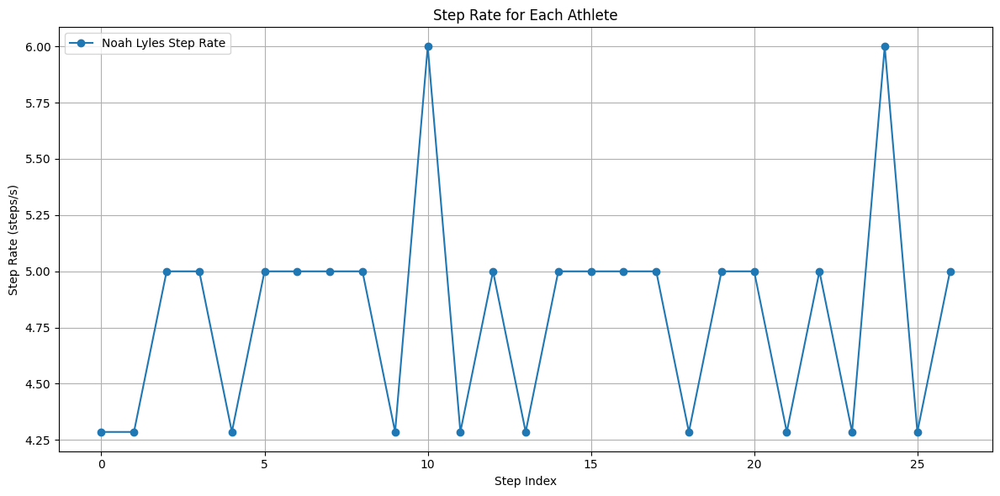

In [31]:
plt.figure(figsize=(12, 6))

plt.plot(noah_step_rate, label="Noah Lyles Step Rate", marker='o')

plt.xlabel("Step Index")
plt.ylabel("Step Rate (steps/s)")
plt.title("Step Rate for Each Athlete")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

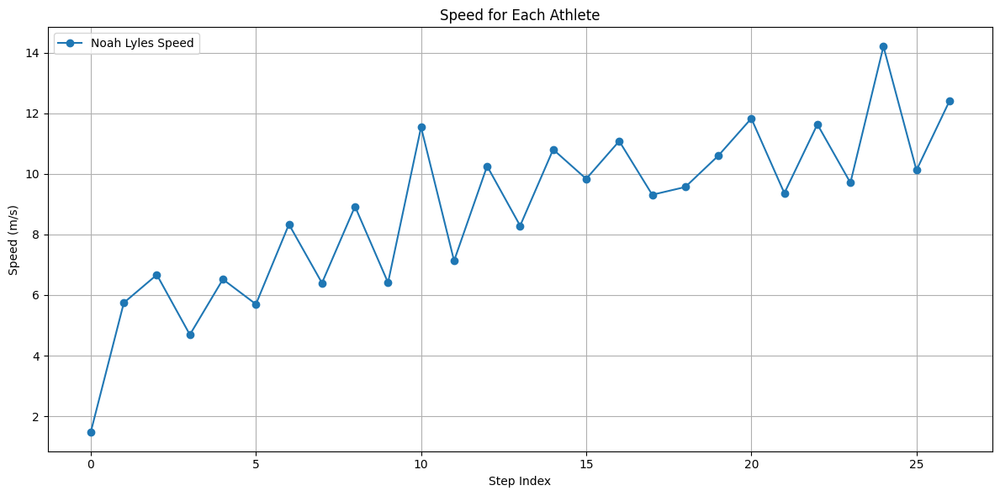

In [32]:
plt.figure(figsize=(12, 6))

plt.plot(noahspeed, label="Noah Lyles Speed", marker='o')

plt.xlabel("Step Index")
plt.ylabel("Speed (m/s)")
plt.title("Speed for Each Athlete")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

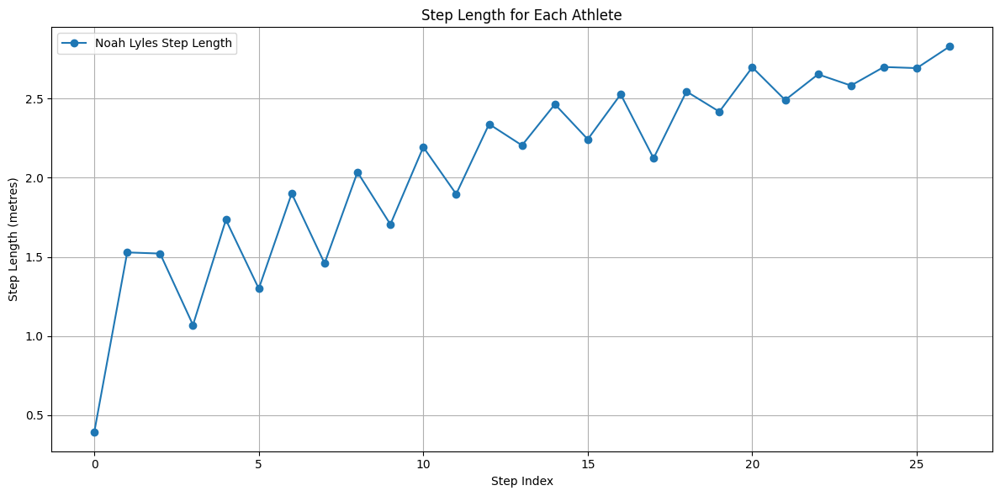

In [33]:
plt.figure(figsize=(12, 6))

plt.plot(noah_step_length, label="Noah Lyles Step Length", marker='o')

plt.xlabel("Step Index")
plt.ylabel("Step Length (metres)")
plt.title("Step Length for Each Athlete")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

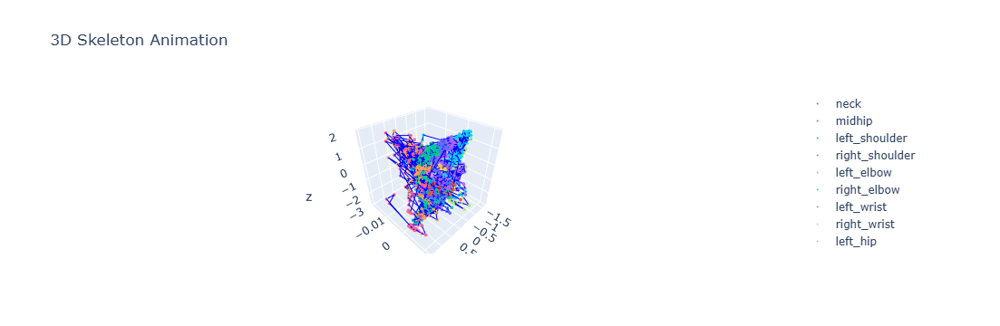

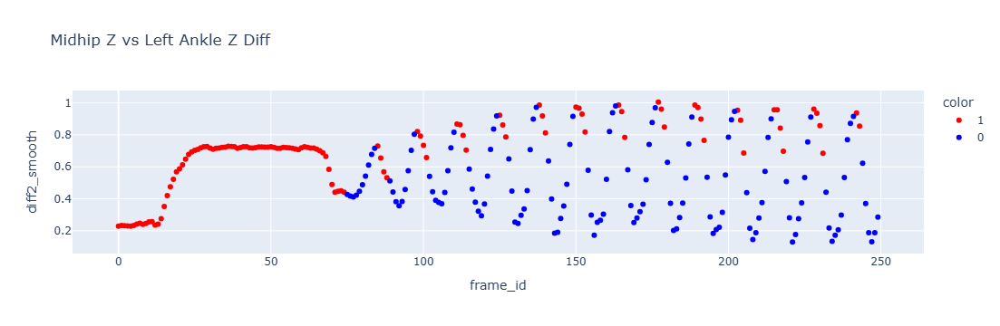

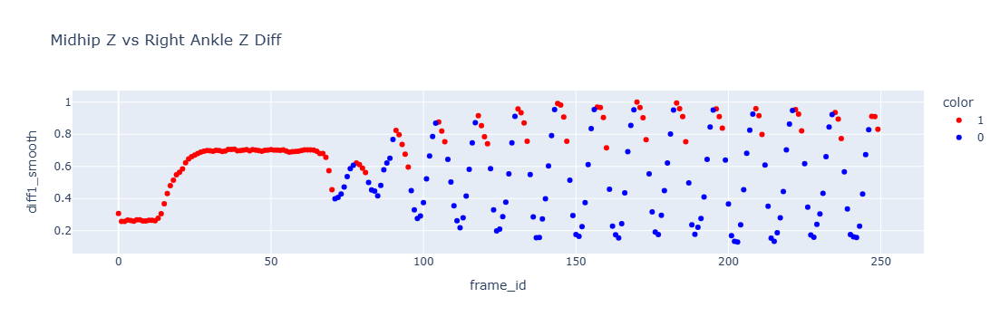

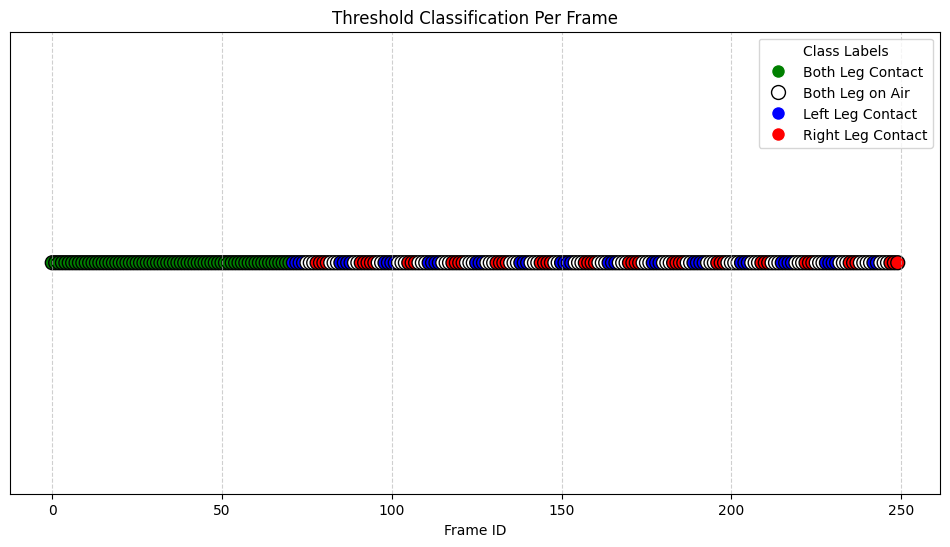

{'left': {'accuracy': 0.94, 'precision': 0.9666666666666667, 'recall': 0.9133858267716536}, 'right': {'accuracy': 0.968, 'precision': 0.9508196721311475, 'recall': 0.9830508474576272}}
leg_length_normalized 1.0003404445814106
Leg length at peak (normalized): 1.0003 → Scale factor: 0.8997


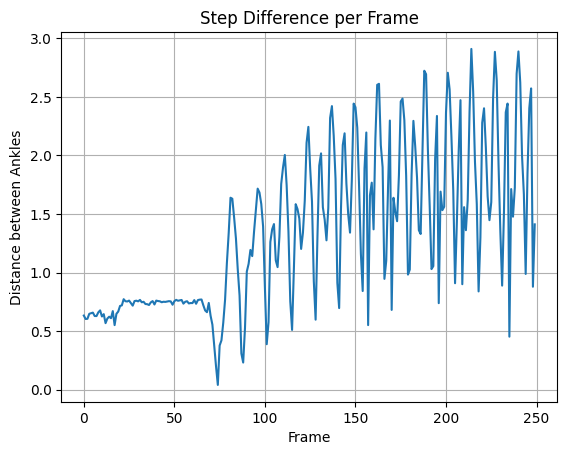

In [34]:
letsile_8 = SkeletonAnalyzerFineTune1("individual_lane_8.csv")
letsile_8.load_and_standardize()
letsile_8.rotate_coordinates()
letsile_8.compute_differences()
letsile_8.correct_outliers()
letsile_8.detect_dip_start()
letsile_8.classify_thresholds()
letsile_8.visualize_skeleton()
letsile_8.visualize_thresholds()
letsile_colors = letsile_8.plot_combined_leg_classification()
letsile_results = letsile_8.evaluate(individual_8_left, individual_8_right)
print(letsile_results)
letsile8_air, letsile8_contact = letsile_8.compute_contact_air_durations()
letsile = letsile_8.compute_step_rate()
letsile_step_rate = []
for i in letsile:
    letsile_step_rate.append(i['step_rate'])
letsile_step_length = []
letsileResult = letsile_8.compute_step_length()
letsile_scaling = float(letsile_8.estimate_scale_factor_from_leg_peak(real_leg_length_meters=0.9))
for i in letsileResult:
    i['max_distance'] *= letsile_scaling
    letsile_step_length.append(i['max_distance'])
letsile_8.compute_step_difference_per_frame()
letsile_speed = letsile_8.compute_speed()
letsilespeed = []
for i in letsile_speed:
    letsilespeed.append(i['speed_mps'])

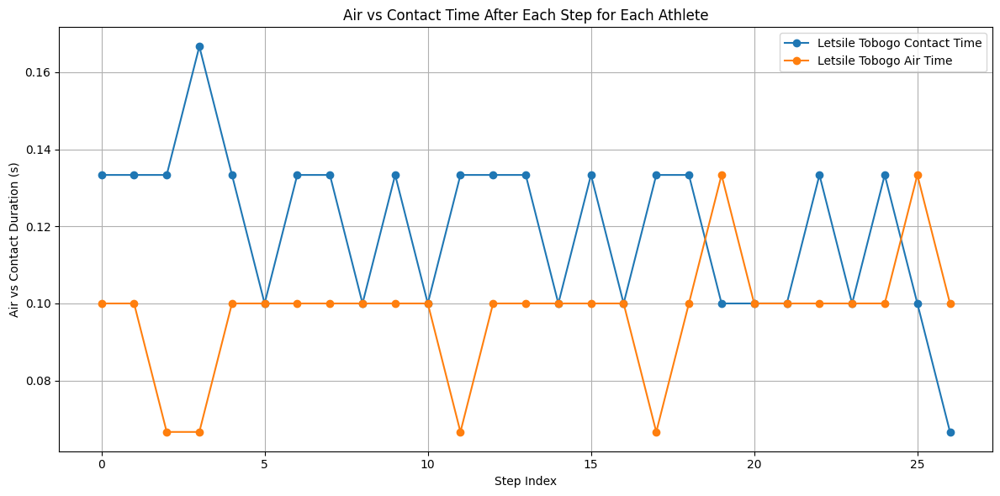

In [35]:
plt.figure(figsize=(12, 6))

plt.plot(letsile8_contact, label="Letsile Tobogo Contact Time", marker='o')
plt.plot(letsile8_air, label="Letsile Tobogo Air Time", marker='o')

plt.xlabel("Step Index")
plt.ylabel("Air vs Contact Duration (s)")
plt.title("Air vs Contact Time After Each Step for Each Athlete")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

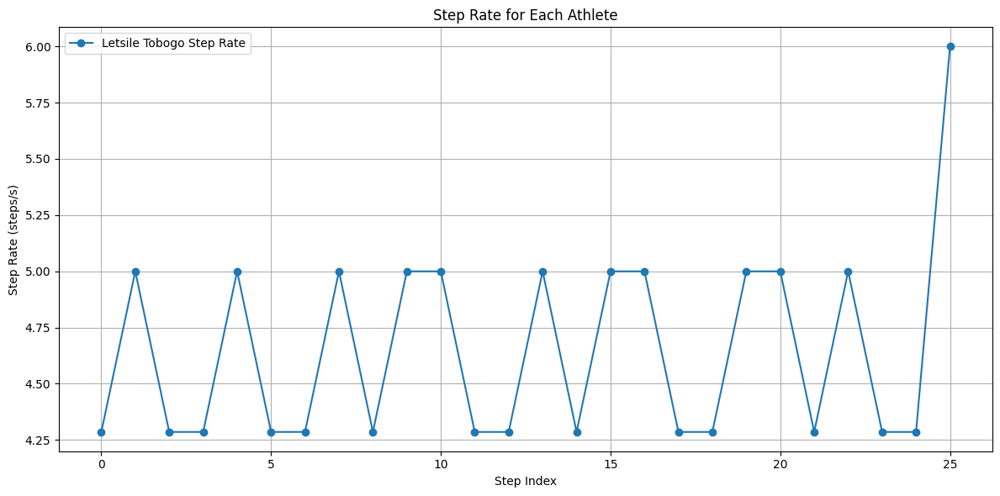

In [36]:
plt.figure(figsize=(12, 6))

plt.plot(letsile_step_rate, label="Letsile Tobogo Step Rate", marker='o')

plt.xlabel("Step Index")
plt.ylabel("Step Rate (steps/s)")
plt.title("Step Rate for Each Athlete")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

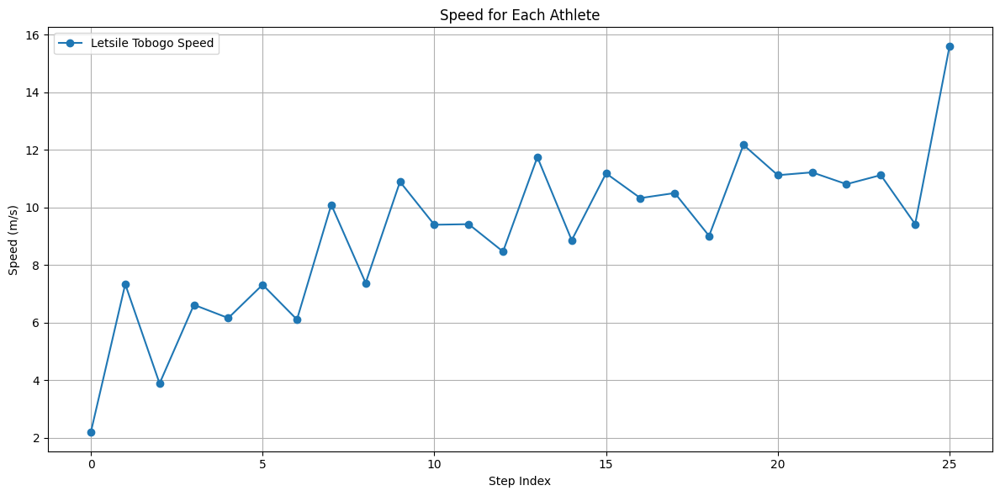

In [37]:
plt.figure(figsize=(12, 6))

plt.plot(letsilespeed, label="Letsile Tobogo Speed", marker='o')

plt.xlabel("Step Index")
plt.ylabel("Speed (m/s)")
plt.title("Speed for Each Athlete")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

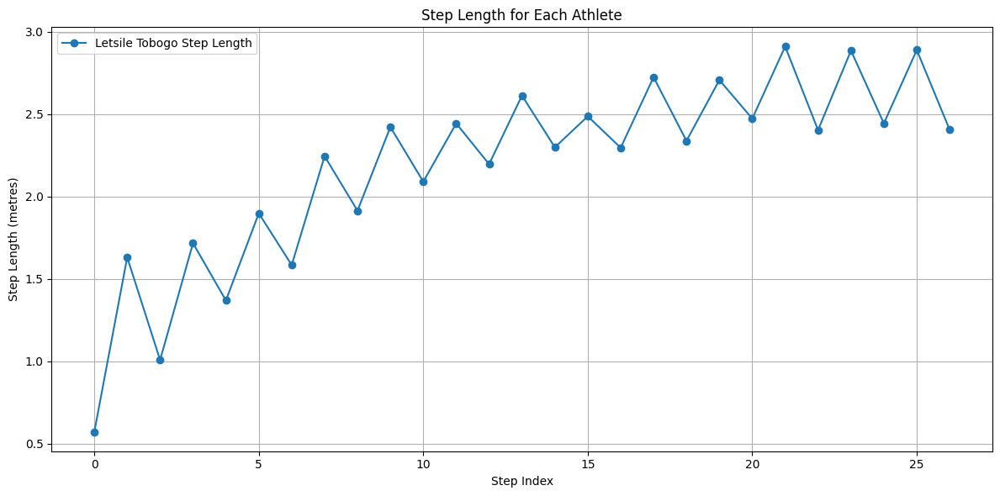

In [38]:
plt.figure(figsize=(12, 6))

plt.plot(letsile_step_length, label="Letsile Tobogo Step Length", marker='o')

plt.xlabel("Step Index")
plt.ylabel("Step Length (metres)")
plt.title("Step Length for Each Athlete")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

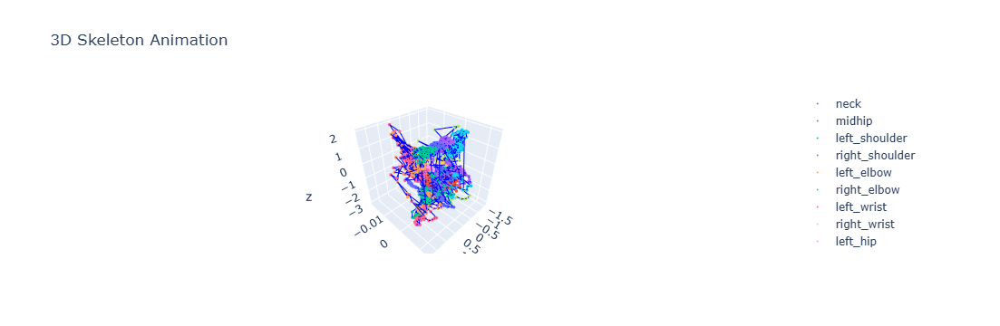

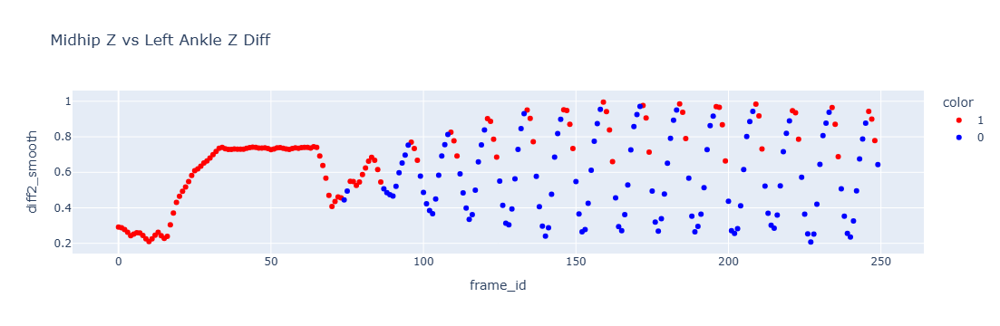

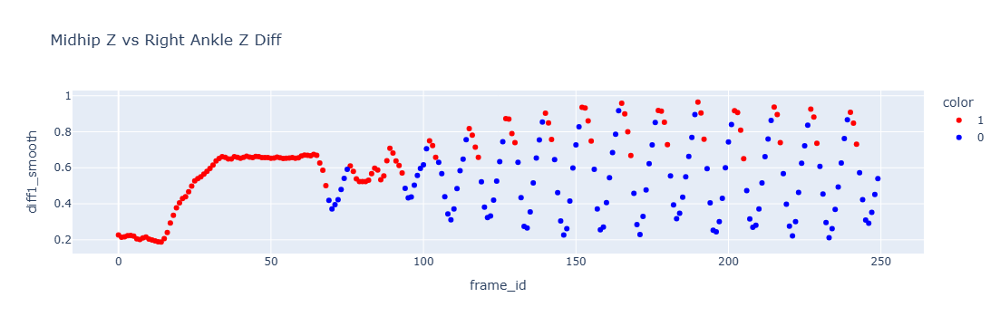

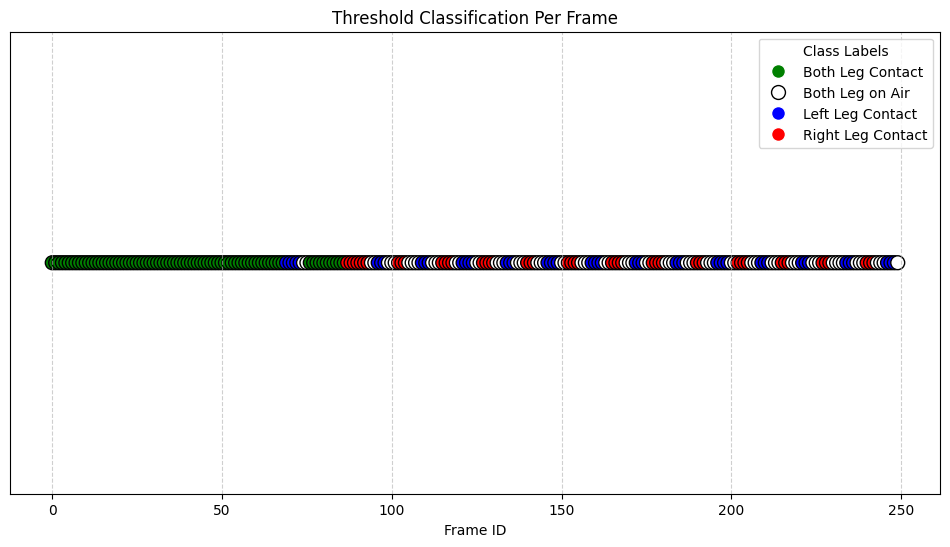

{'left': {'accuracy': 0.924, 'precision': 0.9296875, 'recall': 0.9224806201550387}, 'right': {'accuracy': 0.94, 'precision': 0.9147286821705426, 'recall': 0.9672131147540983}}
leg_length_normalized 0.9648200178609615
Leg length at peak (normalized): 0.9648 → Scale factor: 0.9432


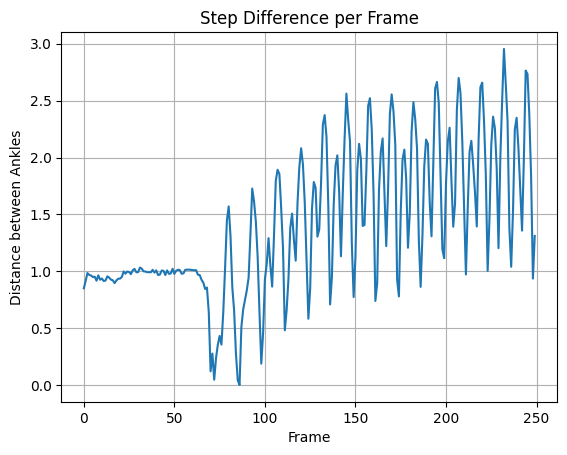

In [39]:
marcell_9 = SkeletonAnalyzerFineTune1("individual_lane_9.csv")
marcell_9.load_and_standardize()
marcell_9.rotate_coordinates()
marcell_9.compute_differences()
marcell_9.correct_outliers()
marcell_9.detect_dip_start()
marcell_9.classify_thresholds()
marcell_9.visualize_skeleton()
marcell_9.visualize_thresholds()
marcell_colors = marcell_9.plot_combined_leg_classification()
marcell_results = marcell_9.evaluate(individual_9_left, individual_9_right)
print(marcell_results)
marcell9_air, marcell9_contact = marcell_9.compute_contact_air_durations()
marcell = marcell_9.compute_step_rate()
marcell_step_rate = []
for i in marcell:
    marcell_step_rate.append(i['step_rate'])
marcell_step_length = []
marcellResult = marcell_9.compute_step_length()
marcell_scaling = float(marcell_9.estimate_scale_factor_from_leg_peak(real_leg_length_meters=0.91))
for i in marcellResult:
    i['max_distance'] *= marcell_scaling
    marcell_step_length.append(i['max_distance'])
marcell_9.compute_step_difference_per_frame()
marcell_speed = marcell_9.compute_speed()
marcellspeed = []
for i in marcell_speed:
    marcellspeed.append(i['speed_mps'])

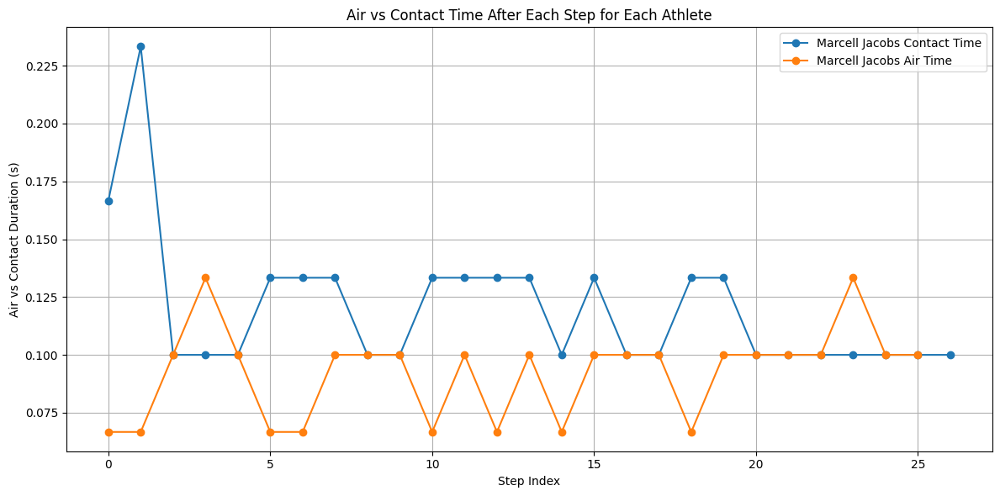

In [40]:
plt.figure(figsize=(12, 6))

plt.plot(marcell9_contact, label="Marcell Jacobs Contact Time", marker='o')
plt.plot(marcell9_air, label="Marcell Jacobs Air Time", marker='o')

plt.xlabel("Step Index")
plt.ylabel("Air vs Contact Duration (s)")
plt.title("Air vs Contact Time After Each Step for Each Athlete")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

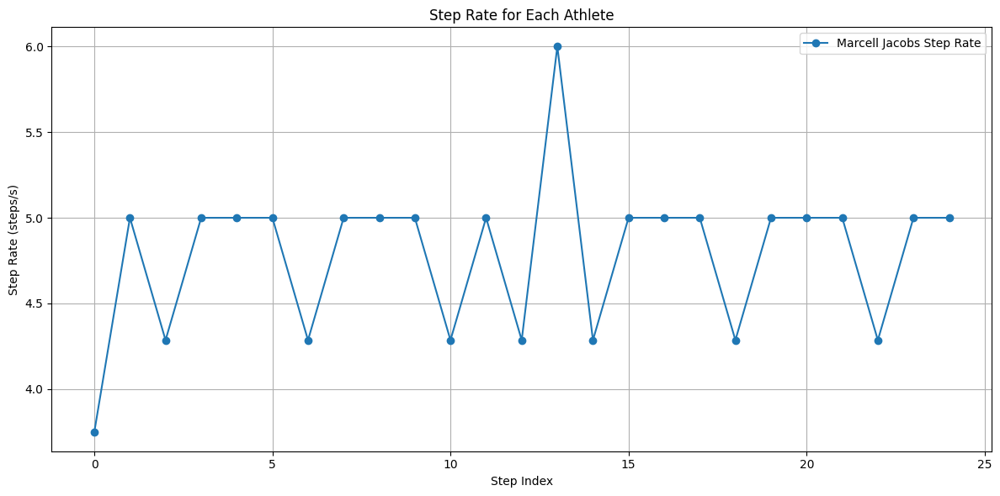

In [41]:
plt.figure(figsize=(12, 6))

plt.plot(marcell_step_rate, label="Marcell Jacobs Step Rate", marker='o')

plt.xlabel("Step Index")
plt.ylabel("Step Rate (steps/s)")
plt.title("Step Rate for Each Athlete")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

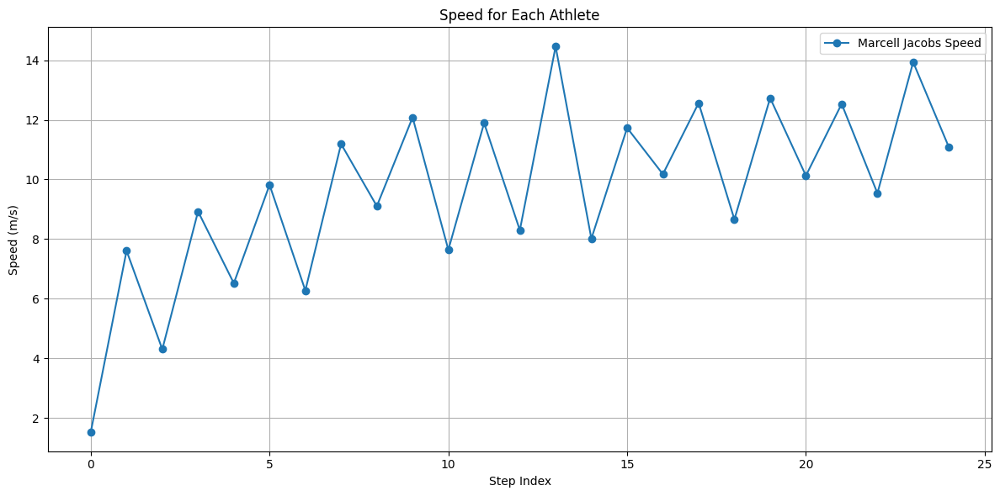

In [42]:
plt.figure(figsize=(12, 6))

plt.plot(marcellspeed, label="Marcell Jacobs Speed", marker='o')

plt.xlabel("Step Index")
plt.ylabel("Speed (m/s)")
plt.title("Speed for Each Athlete")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

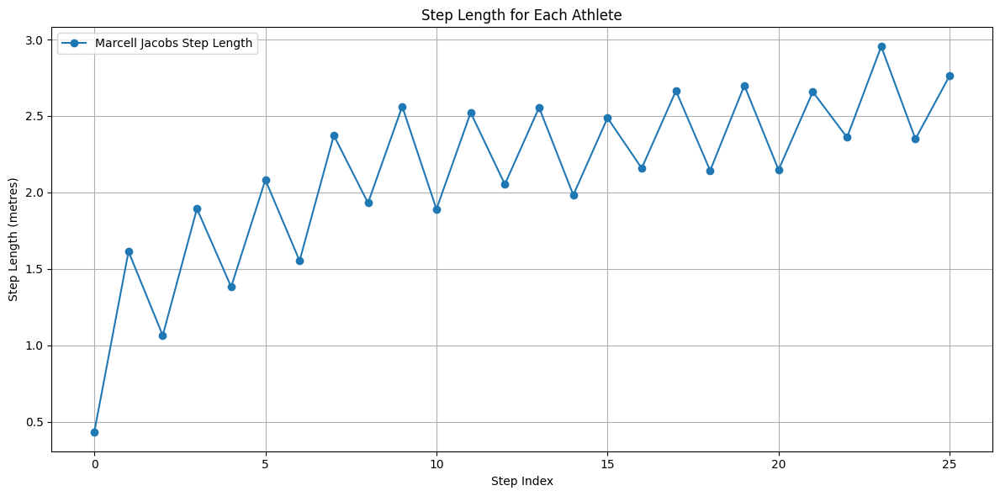

In [43]:
plt.figure(figsize=(12, 6))

plt.plot(marcell_step_length, label="Marcell Jacobs Step Length", marker='o')

plt.xlabel("Step Index")
plt.ylabel("Step Length (metres)")
plt.title("Step Length for Each Athlete")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

# Evaluation Metrics (Threshold Analysis Accuracy)

In [44]:
metrics_summary = []

athletes_info = [
    ("Noah Lyles", "noah"),
    ("Kishane Thompson", "kishane"),
    ("Fred Kerley", "fred"),
    ("Akani Simbine", "akani"),
    ("Marcell Jacobs", "marcell"),
    ("Letsile Tebogo", "letsile"),
    ("Kenny Bednarek", "kenny"),
    ("Oblique Seville", "oblique"),
]

for athlete_name, prefix in athletes_info:
    results = globals()[f"{prefix}_results"]
    metrics_summary.append({
        "Athlete": athlete_name,
        "Accuracy of Left Leg": round(results['left']['accuracy'] * 100, 2),
        "Accuracy of Right Leg": round(results['right']['accuracy'] * 100, 2),
        "Precision of Left Leg": round(results['left']['precision'] * 100, 2),
        "Precision of Right Leg": round(results['right']['precision'] * 100, 2),
        "Recall of Left Leg": round(results['left']['recall'] * 100, 2),
        "Recall of Right Leg": round(results['right']['recall'] * 100, 2),
    })

# Convert to DataFrame
df_metrics = pd.DataFrame(metrics_summary)
df_metrics

,Athlete,Accuracy of Left Leg,Accuracy of Right Leg,Precision of Left Leg,Precision of Right Leg,Recall of Left Leg,Recall of Right Leg
0,Noah Lyles,94.0,95.2,93.70,95.97,94.44,94.44
1,Kishane Thompson,94.8,93.6,95.20,92.13,94.44,95.12
2,Fred Kerley,94.8,94.0,93.65,94.21,95.93,93.44
3,Akani Simbine,94.0,96.0,91.60,96.75,96.77,95.20
4,Marcell Jacobs,92.4,94.0,92.97,91.47,92.25,96.72
5,Letsile Tebogo,94.0,96.8,96.67,95.08,91.34,98.31
6,Kenny Bednarek,96.0,92.8,96.85,92.13,95.35,93.60
7,Oblique Seville,91.2,94.0,91.41,92.25,91.41,95.97


# Athlete Performance Summary

In [45]:
athletes = {
    "Noah Lyles": {
        "step_length": noah_step_length,
        "contact_time": noah7_contact,
        "air_time": noah7_air,
        "step_rate": noah_step_rate,
        "speed": noahspeed,
    },
    "Kishane Thompson": {
        "step_length": kishane_step_length,
        "contact_time": kishane4_contact,
        "air_time": kishane4_air,
        "step_rate": kishane_step_rate,
        "speed": kishanespeed,
    },
    "Fred Kerley": {
        "step_length": fred_step_length,
        "contact_time": fred3_contact,
        "air_time": fred3_air,
        "step_rate": fred_step_rate,
        "speed": fredspeed,
    },
    "Akani Simbine": {
        "step_length": akani_step_length,
        "contact_time": akani5_contact,
        "air_time": akani5_air,
        "step_rate": akani_step_rate,
        "speed": akanispeed,
    },
    "Marcell Jacobs": {
        "step_length": marcell_step_length,
        "contact_time": marcell9_contact,
        "air_time": marcell9_air,
        "step_rate": marcell_step_rate,
        "speed": marcellspeed,
    },
    "Letsile Tebogo": {
        "step_length": letsile_step_length,
        "contact_time": letsile8_contact,
        "air_time": letsile8_air,
        "step_rate": letsile_step_rate,
        "speed": letsilespeed,
    },
    "Kenny Bednarek": {
        "step_length": kenny_step_length,
        "contact_time": kenny2_contact,
        "air_time": kenny2_air,
        "step_rate": kenny_step_rate,
        "speed": kennyspeed,
    },
    "Oblique Seville": {
        "step_length": oblique_step_length,
        "contact_time": oblique6_contact,
        "air_time": oblique6_air,
        "step_rate": oblique_step_rate,
        "speed": obliquespeed,
    },
}

rows = []
for name, metrics in athletes.items():
    row = {
        "Athlete": name,
        "Avg Step Length (m)": round(np.mean(metrics["step_length"]), 3),
        "Avg Contact Time (s)": round(np.mean(metrics["contact_time"]), 3),
        "Avg Air Time (s)": round(np.mean(metrics["air_time"]), 3),
        "Step Frequency (Hz)": round(np.mean(metrics["step_rate"]), 3),
        "Top Speed (m/s)": round(max(metrics["speed"]), 3),
    }
    rows.append(row)

df_summary = pd.DataFrame(rows)
print(df_summary)

            Athlete  Avg Step Length (m)  Avg Contact Time (s)  \
0        Noah Lyles                2.083                 0.130   
1  Kishane Thompson                2.034                 0.126   
2       Fred Kerley                2.521                 0.133   
3     Akani Simbine                2.161                 0.133   
4    Marcell Jacobs                2.126                 0.120   
5    Letsile Tebogo                2.184                 0.120   
6    Kenny Bednarek                2.273                 0.130   
7   Oblique Seville                1.825                 0.130   

   Avg Air Time (s)  Step Frequency (Hz)  Top Speed (m/s)  
0             0.088                4.810           14.211  
1             0.081                4.851           14.929  
2             0.094                4.815           17.352  
3             0.079                5.936           43.484  
4             0.092                4.790           14.462  
5             0.098                4.654     